# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [8]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [9]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [18]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [19]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [20]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [21]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [22]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [23]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [24]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.384150931596756, discriminator loss: 0.24302957899309693


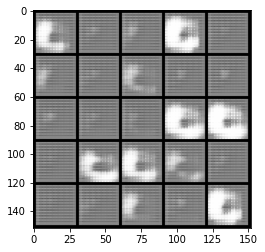

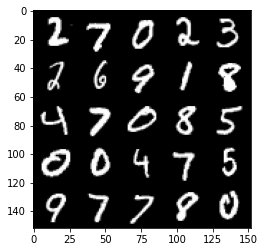

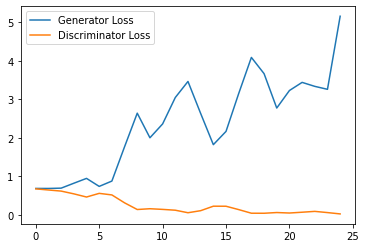

Step 1000: Generator loss: 4.5381990804672245, discriminator loss: 0.05375732308626175


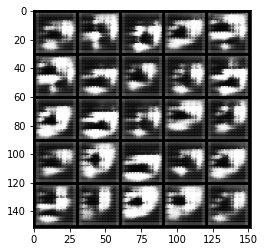

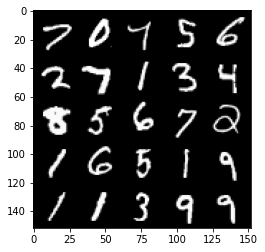

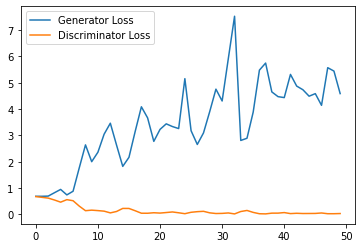

Step 1500: Generator loss: 4.330397600650787, discriminator loss: 0.05221417826041579


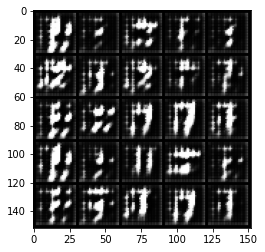

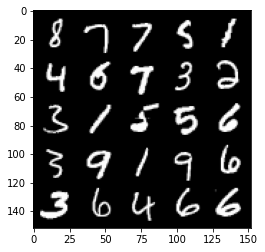

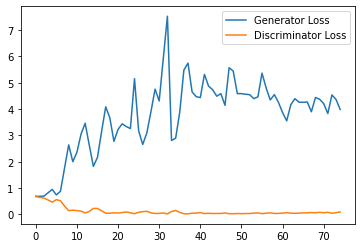

Step 2000: Generator loss: 3.673029050350189, discriminator loss: 0.09847367050498725


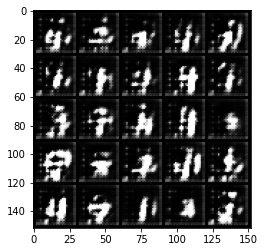

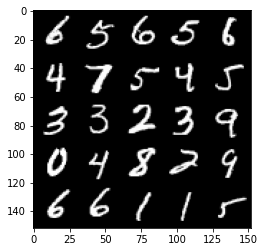

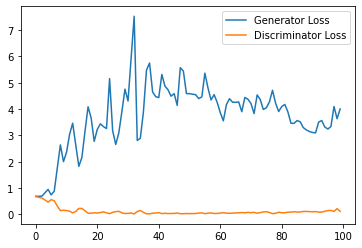

Step 2500: Generator loss: 3.043871731042862, discriminator loss: 0.18338416078686715


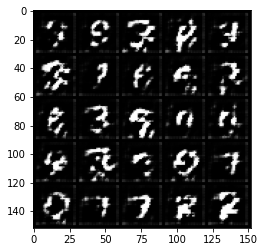

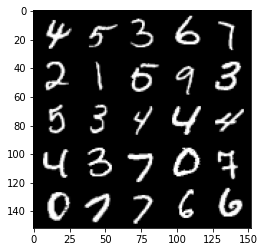

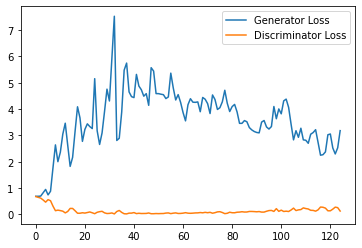

Step 3000: Generator loss: 2.6150398490428923, discriminator loss: 0.24033879098296165


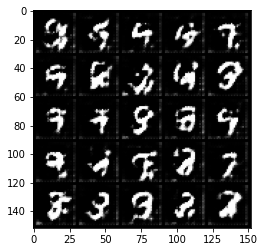

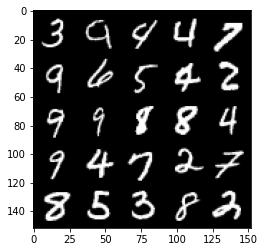

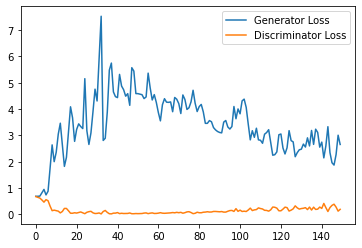

Step 3500: Generator loss: 2.2949518177509307, discriminator loss: 0.27584738507866857


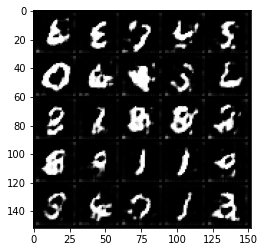

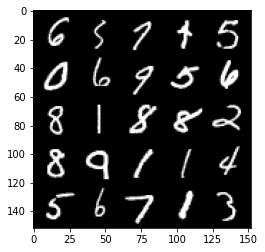

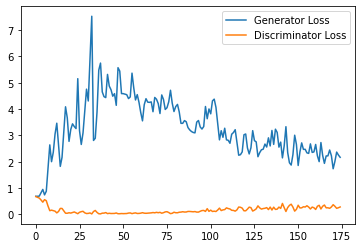

Step 4000: Generator loss: 2.130942902088165, discriminator loss: 0.3125478084385395


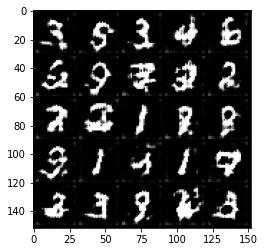

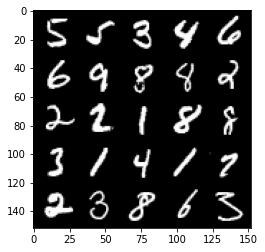

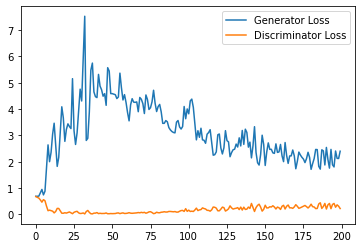

Step 4500: Generator loss: 2.083687485694885, discriminator loss: 0.3274836162030697


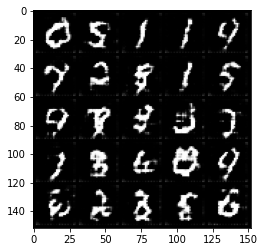

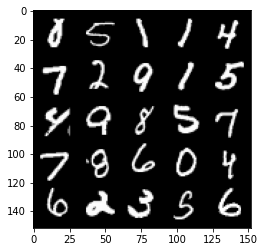

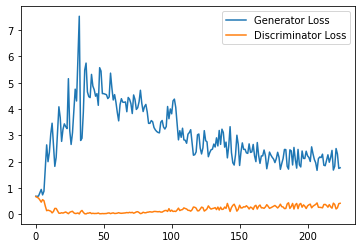

Step 5000: Generator loss: 2.140195316553116, discriminator loss: 0.3422190327048302


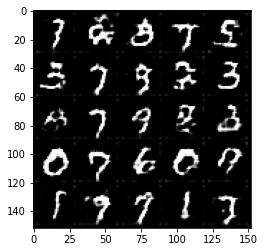

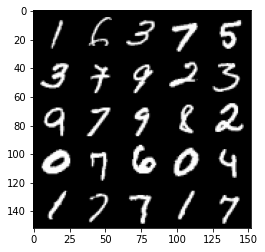

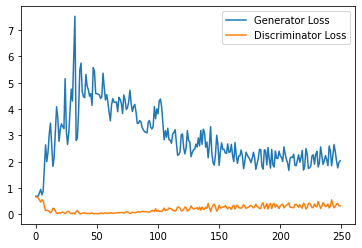

Step 5500: Generator loss: 1.8795739886760712, discriminator loss: 0.3685397441089153


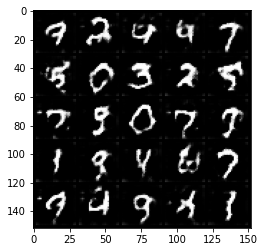

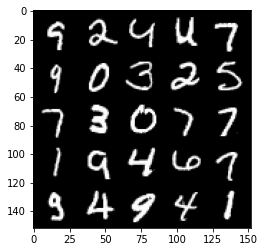

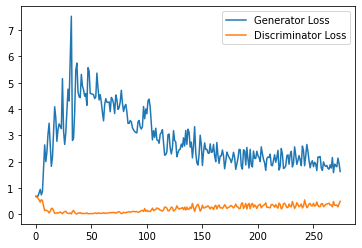

Step 6000: Generator loss: 1.7080136046409606, discriminator loss: 0.3925581732690334


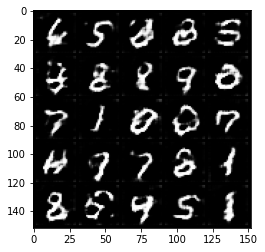

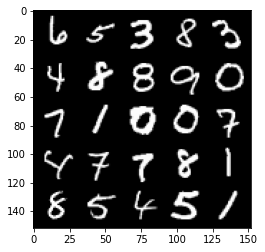

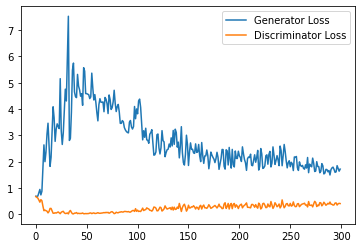

Step 6500: Generator loss: 1.6268875017166138, discriminator loss: 0.43410106948018073


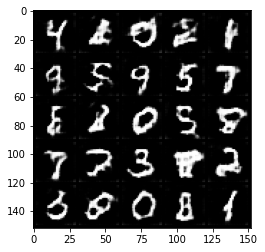

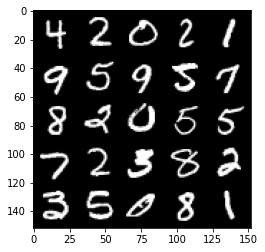

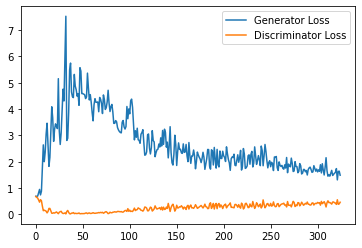

Step 7000: Generator loss: 1.5649660384655, discriminator loss: 0.45796901553869246


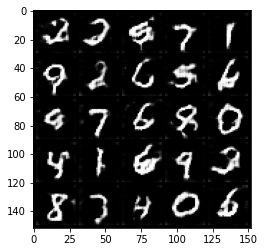

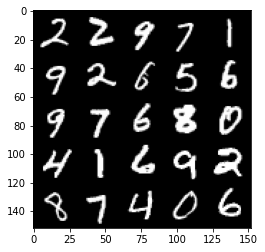

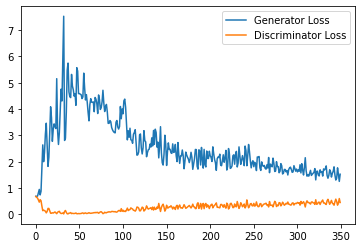

Step 7500: Generator loss: 1.4957118339538573, discriminator loss: 0.4608352484703064


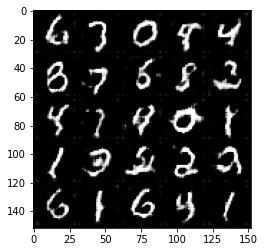

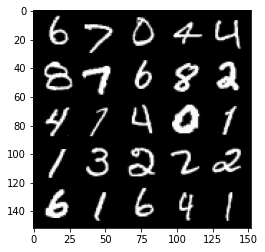

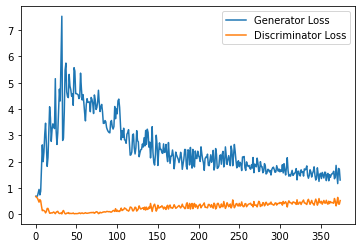

Step 8000: Generator loss: 1.503715292096138, discriminator loss: 0.47124292379617694


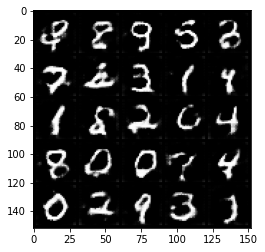

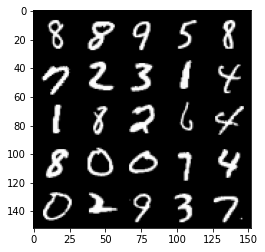

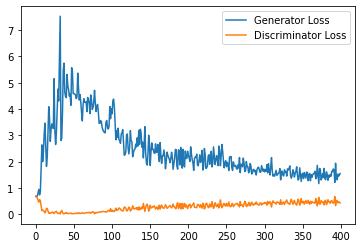

Step 8500: Generator loss: 1.4122219444513322, discriminator loss: 0.4810066267848015


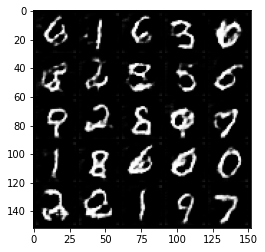

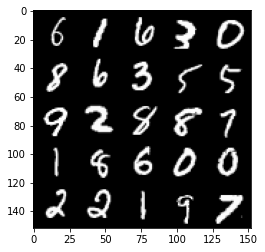

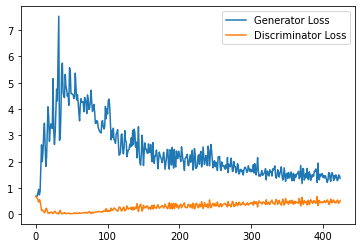

Step 9000: Generator loss: 1.4075006668567658, discriminator loss: 0.48554271507263186


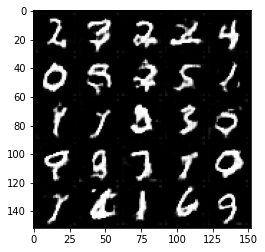

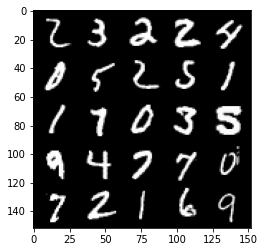

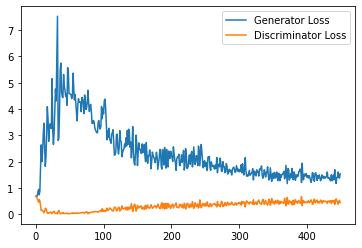

Step 9500: Generator loss: 1.4172681261301041, discriminator loss: 0.501778082728386


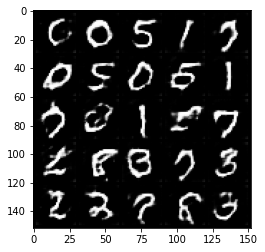

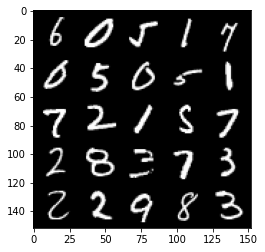

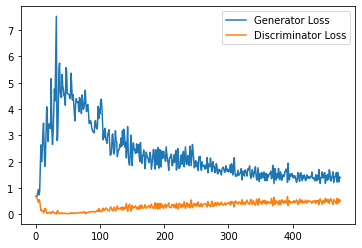

Step 10000: Generator loss: 1.3439346191883088, discriminator loss: 0.49536461210250854


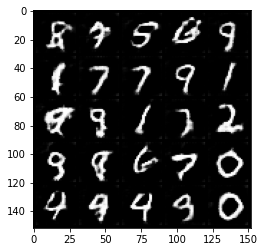

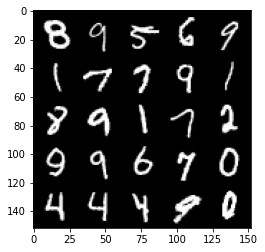

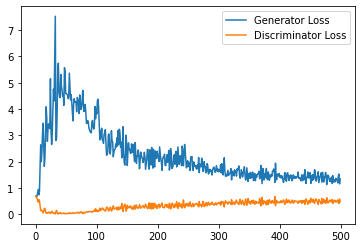

Step 10500: Generator loss: 1.2881141242980958, discriminator loss: 0.49534424793720244


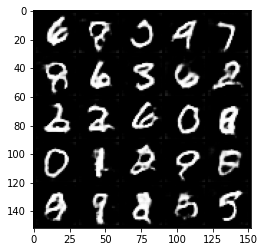

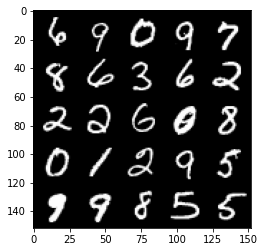

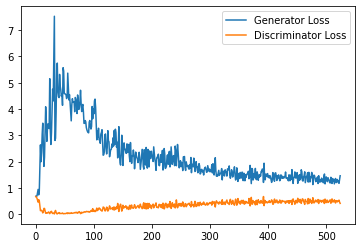

Step 11000: Generator loss: 1.2687697316408157, discriminator loss: 0.5091610381603241


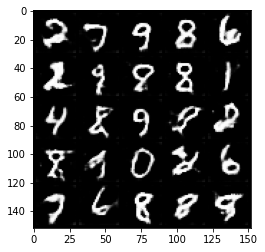

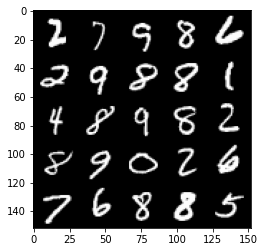

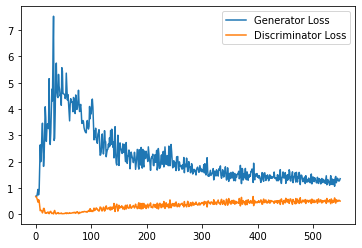

Step 11500: Generator loss: 1.2973709594011307, discriminator loss: 0.5066203495264053


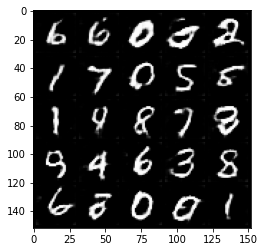

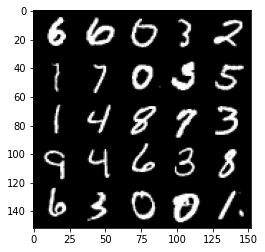

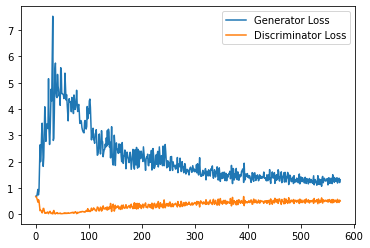

Step 12000: Generator loss: 1.2938682714700698, discriminator loss: 0.5137612618803978


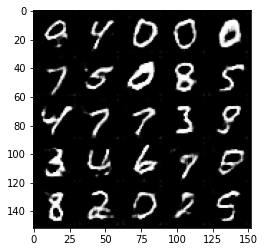

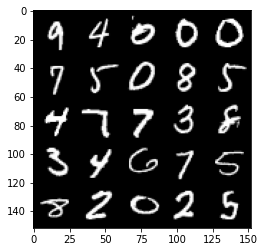

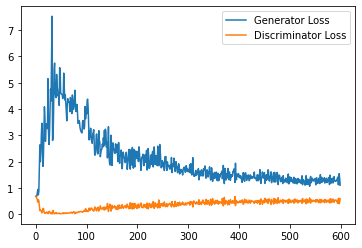

Step 12500: Generator loss: 1.2778111839294433, discriminator loss: 0.5199924776554108


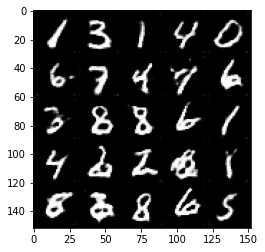

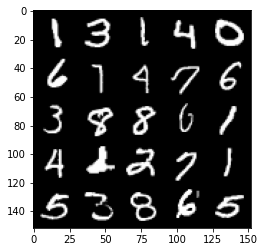

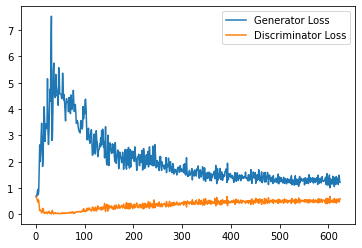

Step 13000: Generator loss: 1.2813065235614776, discriminator loss: 0.5201314596533775


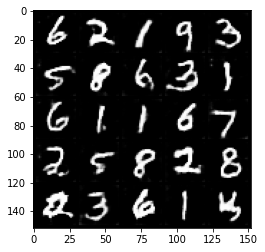

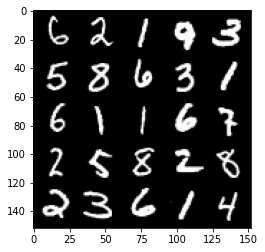

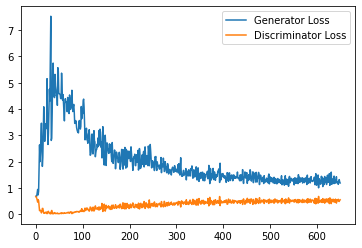

Step 13500: Generator loss: 1.23905022418499, discriminator loss: 0.5226470580101014


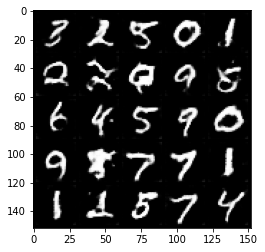

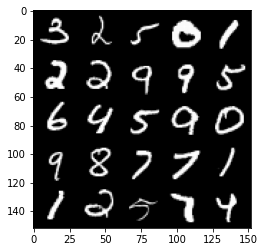

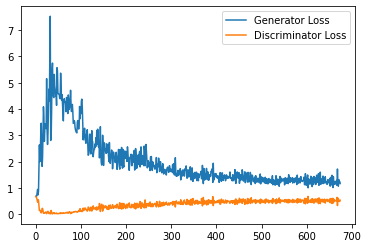

Step 14000: Generator loss: 1.1971739085912705, discriminator loss: 0.5287744940519333


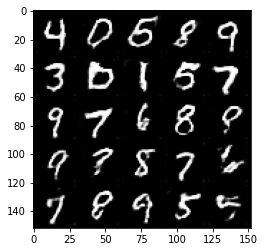

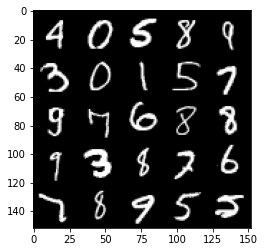

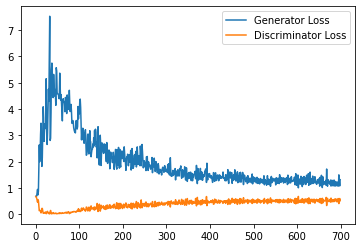

Step 14500: Generator loss: 1.2523484119176864, discriminator loss: 0.5327334015965461


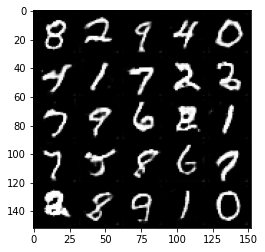

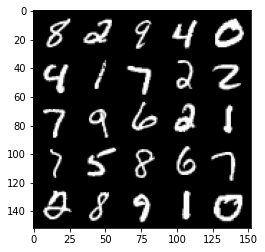

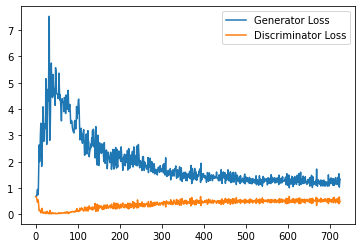

Step 15000: Generator loss: 1.2364502093791963, discriminator loss: 0.531005114197731


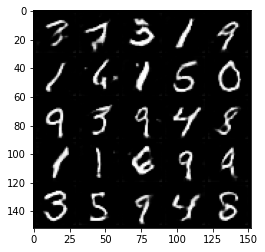

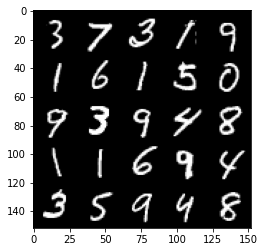

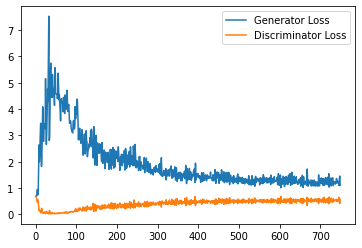

Step 15500: Generator loss: 1.2010641312599182, discriminator loss: 0.5332151681780816


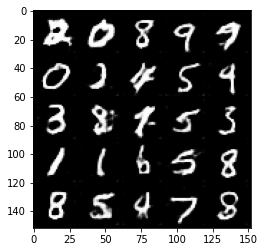

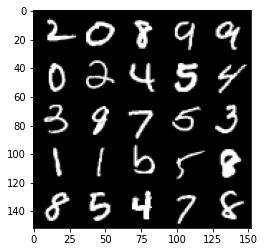

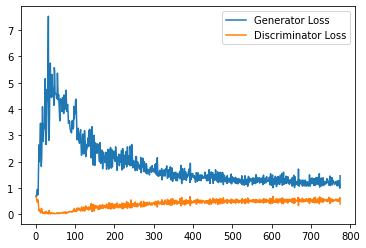

Step 16000: Generator loss: 1.1747080564498902, discriminator loss: 0.5344816187620163


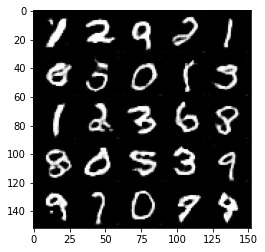

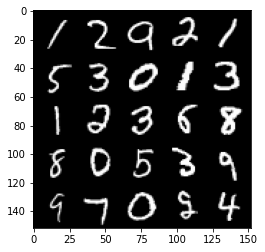

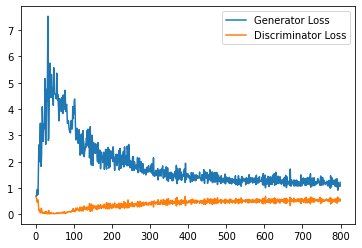

Step 16500: Generator loss: 1.137869537472725, discriminator loss: 0.5422073270082474


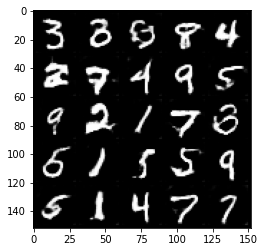

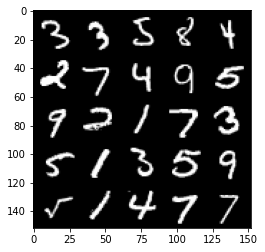

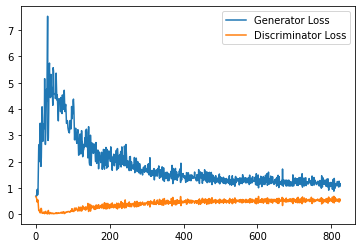

Step 17000: Generator loss: 1.1514401061534882, discriminator loss: 0.5442282834649086


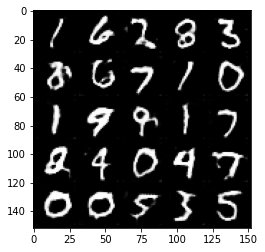

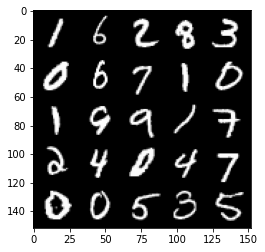

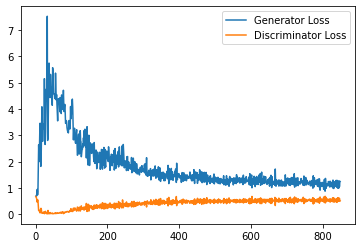

Step 17500: Generator loss: 1.157170336484909, discriminator loss: 0.5506446336507798


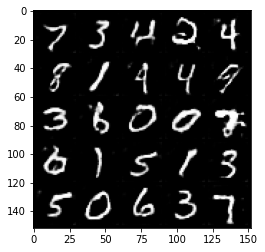

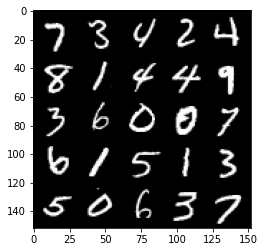

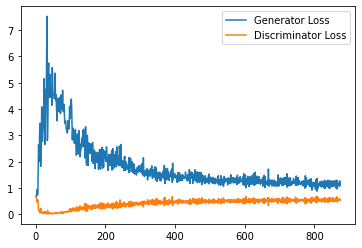

Step 18000: Generator loss: 1.180561297774315, discriminator loss: 0.5586041161417961


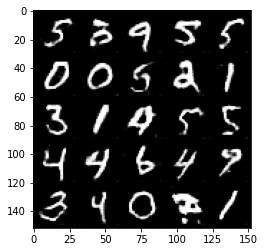

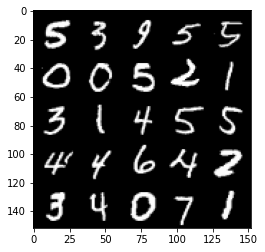

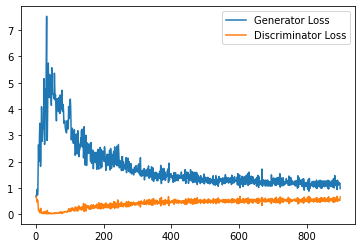

Step 18500: Generator loss: 1.1312567949295045, discriminator loss: 0.5597585945129394


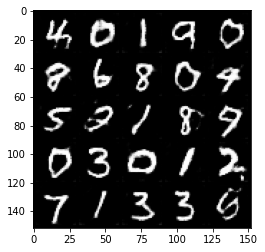

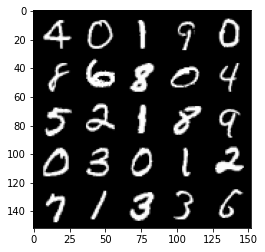

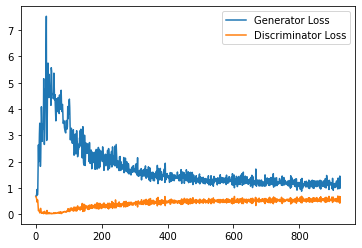

Step 19000: Generator loss: 1.13726247048378, discriminator loss: 0.5543982015252114


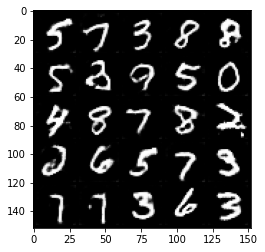

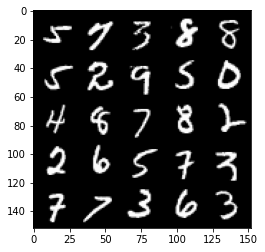

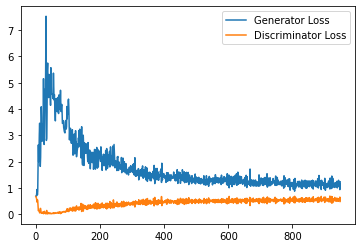

Step 19500: Generator loss: 1.1008733471632004, discriminator loss: 0.5671282299757003


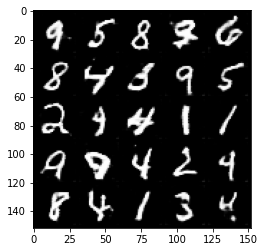

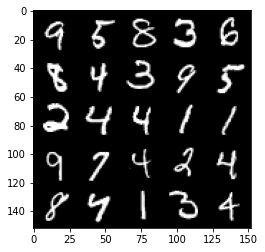

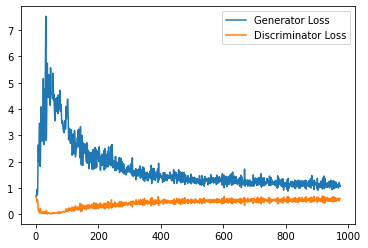

Step 20000: Generator loss: 1.1130653502941132, discriminator loss: 0.5632548120617866


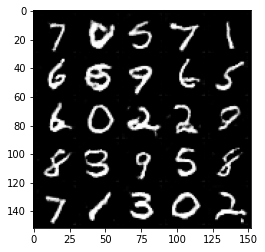

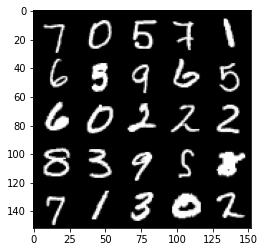

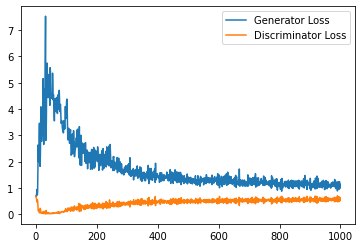

Step 20500: Generator loss: 1.116238975405693, discriminator loss: 0.5672579374909401


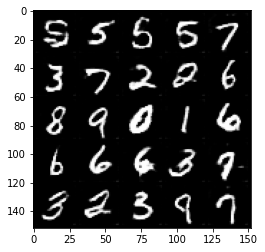

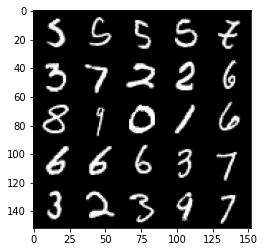

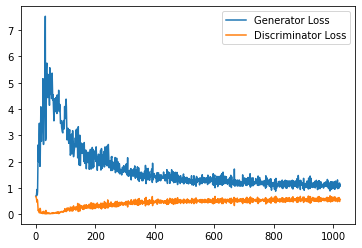

Step 21000: Generator loss: 1.0721849969625472, discriminator loss: 0.5711601940989495


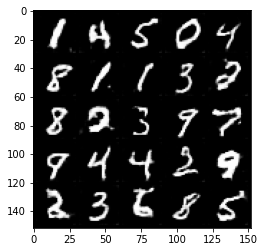

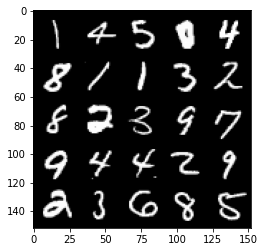

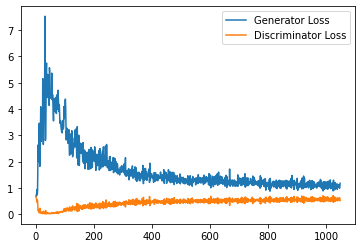

Step 21500: Generator loss: 1.0829439985752105, discriminator loss: 0.5684867095351219


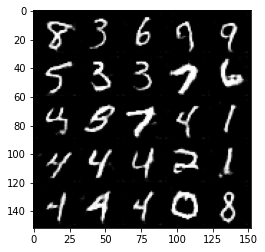

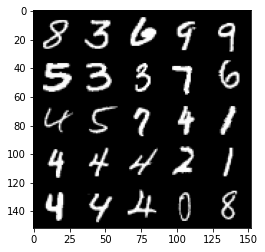

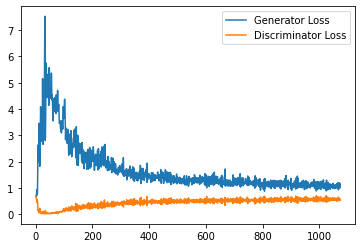

Step 22000: Generator loss: 1.0994861075878144, discriminator loss: 0.5742702468633651


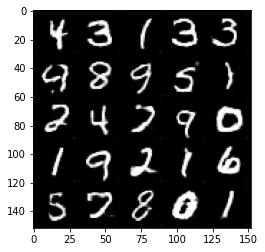

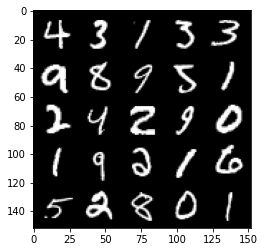

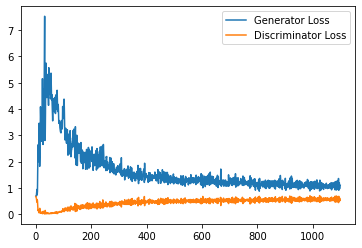

Step 22500: Generator loss: 1.0987077785730361, discriminator loss: 0.5674007954597473


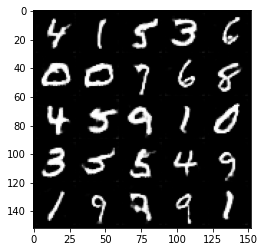

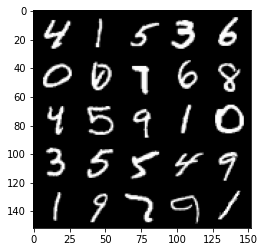

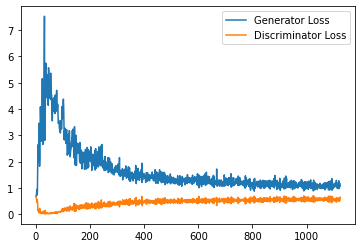

Step 23000: Generator loss: 1.0897140827178955, discriminator loss: 0.5750668119192124


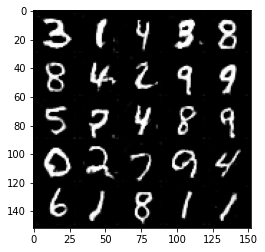

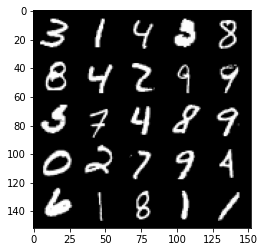

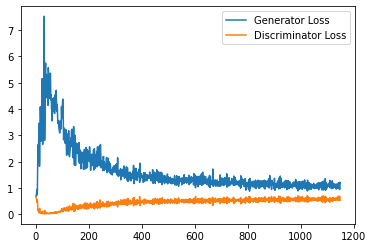

Step 23500: Generator loss: 1.0881990840435027, discriminator loss: 0.5741064475178719


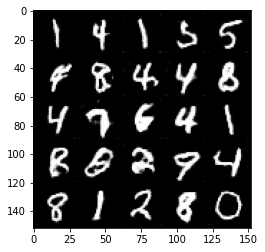

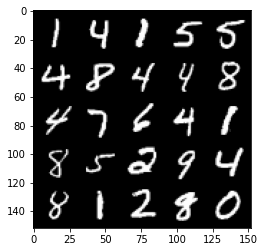

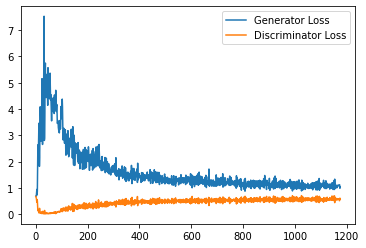

Step 24000: Generator loss: 1.0628243225812912, discriminator loss: 0.5739043359756469


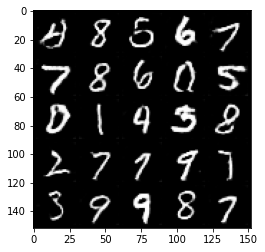

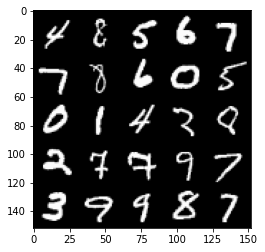

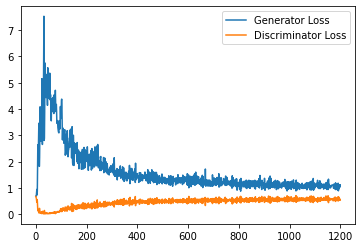

Step 24500: Generator loss: 1.0627273663282395, discriminator loss: 0.5780048950910568


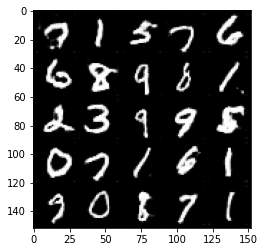

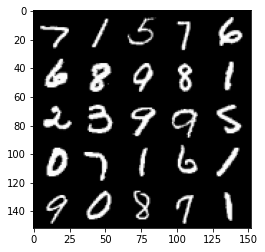

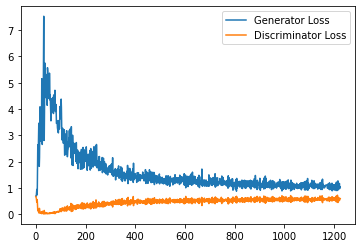

Step 25000: Generator loss: 1.0568070867061614, discriminator loss: 0.5794702809453011


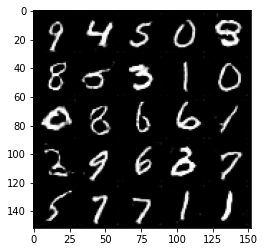

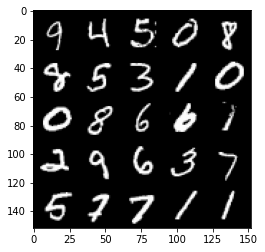

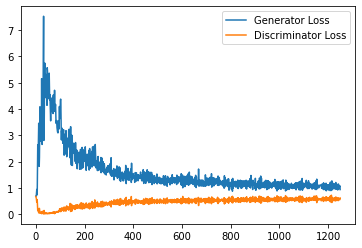

Step 25500: Generator loss: 1.0455594396591186, discriminator loss: 0.5807413371801377


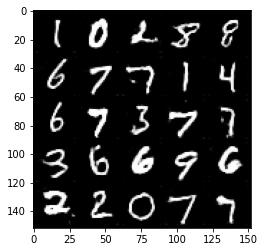

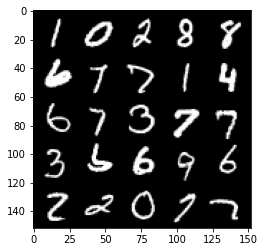

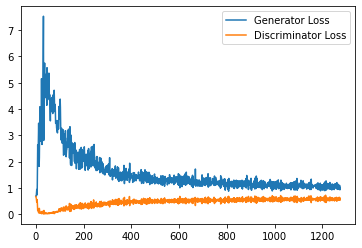

Step 26000: Generator loss: 1.0072945162057876, discriminator loss: 0.5878527116179466


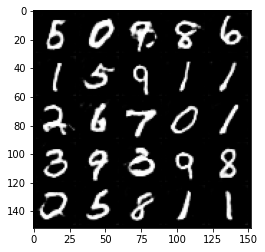

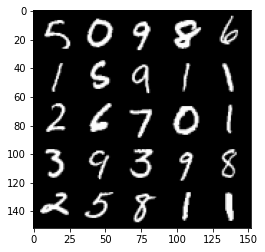

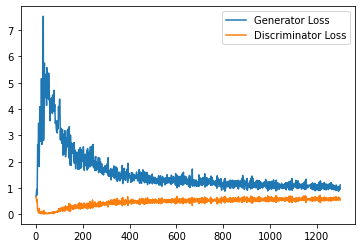

Step 26500: Generator loss: 1.0635770955085755, discriminator loss: 0.5832459305524826


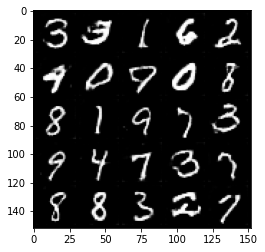

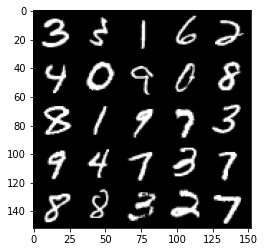

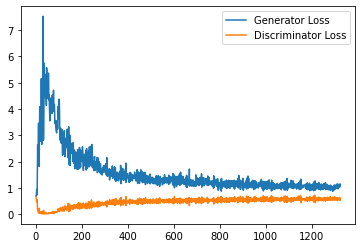

Step 27000: Generator loss: 1.0397659730911255, discriminator loss: 0.589581787109375


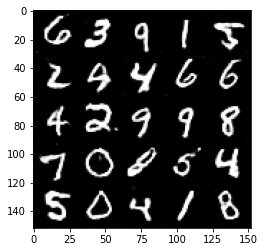

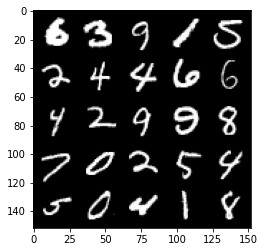

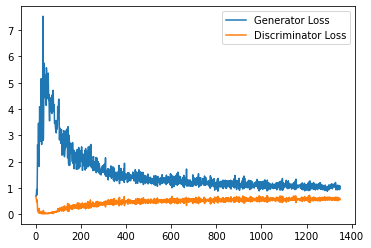

Step 27500: Generator loss: 1.0498654546737671, discriminator loss: 0.5869682515263558


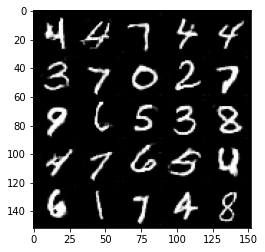

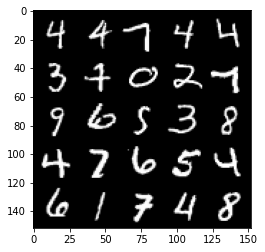

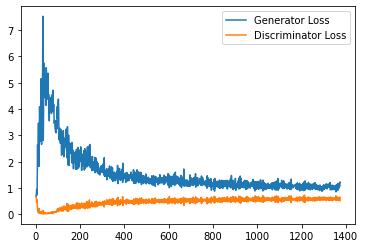

Step 28000: Generator loss: 1.0596865735054015, discriminator loss: 0.5936629995107651


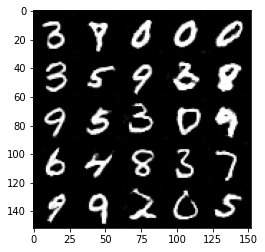

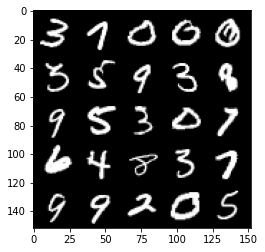

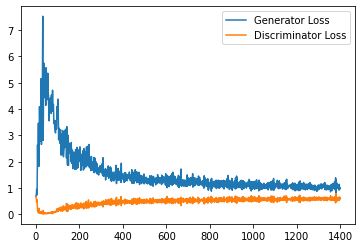

Step 28500: Generator loss: 1.0301117868423462, discriminator loss: 0.5877189534306526


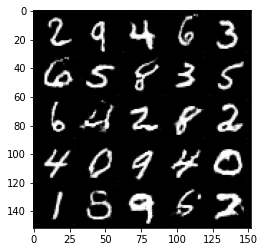

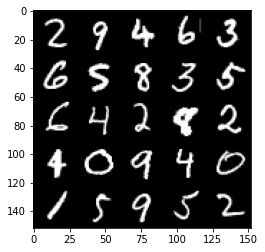

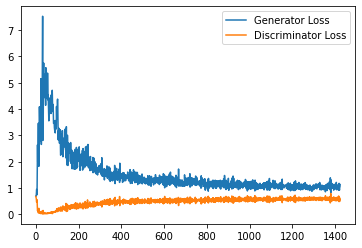

Step 29000: Generator loss: 1.018229376077652, discriminator loss: 0.5956899644136429


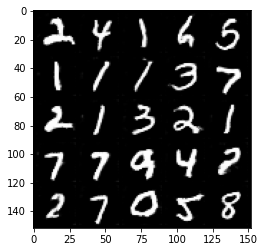

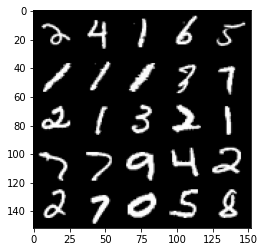

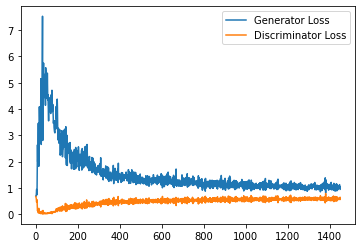

Step 29500: Generator loss: 1.0591781224012375, discriminator loss: 0.5952943323254585


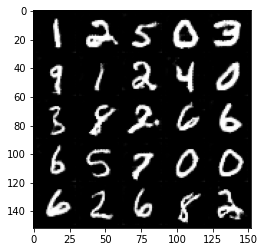

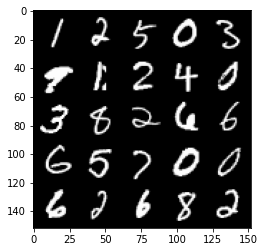

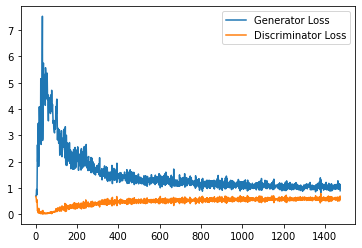

Step 30000: Generator loss: 1.0343236629962922, discriminator loss: 0.5897540004253388


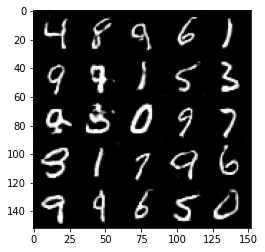

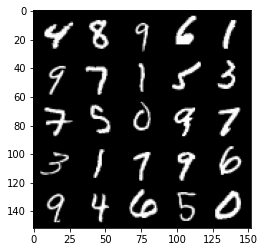

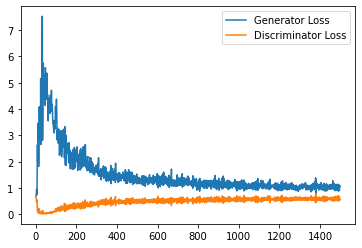

Step 30500: Generator loss: 1.0019133989810944, discriminator loss: 0.5946882636547088


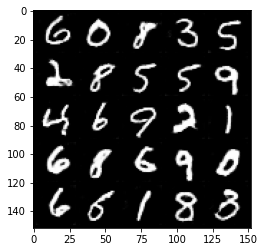

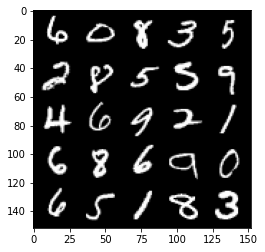

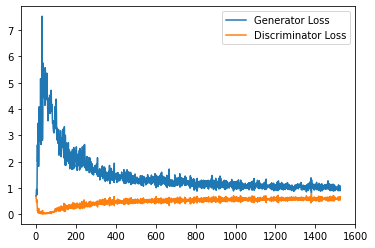

Step 31000: Generator loss: 1.0187545322179794, discriminator loss: 0.5933682424426079


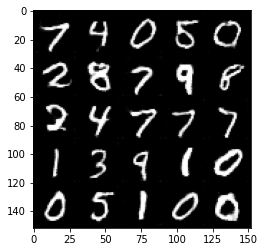

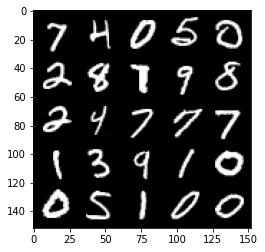

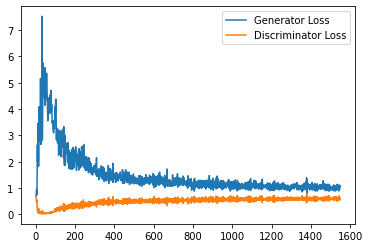

Step 31500: Generator loss: 1.0455209524631501, discriminator loss: 0.595027528166771


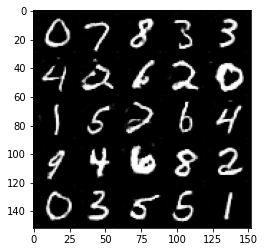

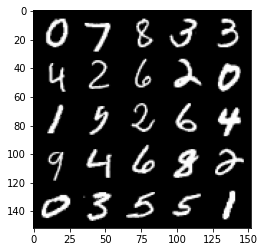

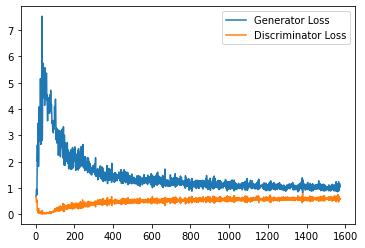

Step 32000: Generator loss: 1.0234229420423508, discriminator loss: 0.5943660858869553


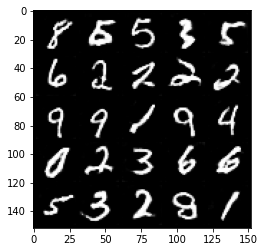

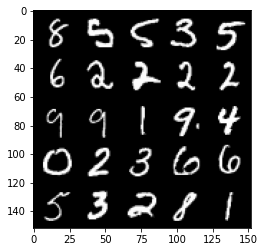

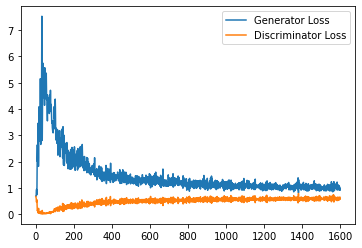

Step 32500: Generator loss: 1.0054188462495803, discriminator loss: 0.5892661712765693


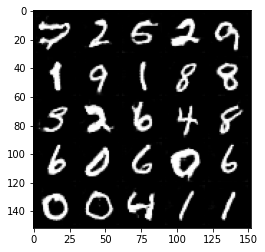

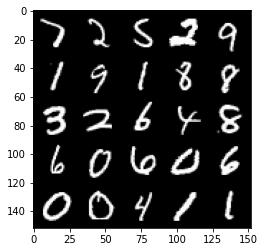

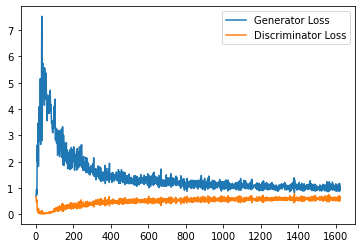

Step 33000: Generator loss: 1.0222801381349564, discriminator loss: 0.5917790522575378


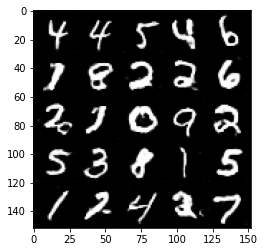

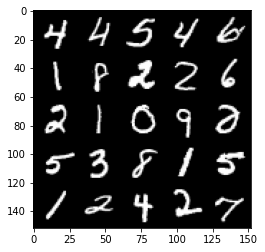

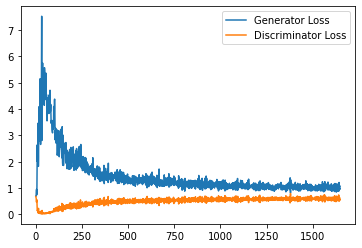

Step 33500: Generator loss: 0.9932356128692627, discriminator loss: 0.5953810601234436


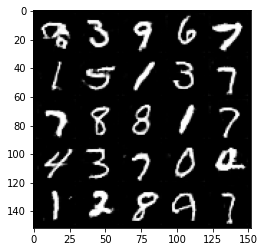

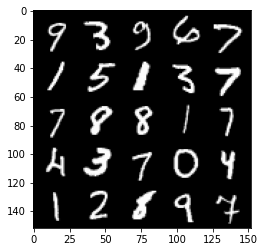

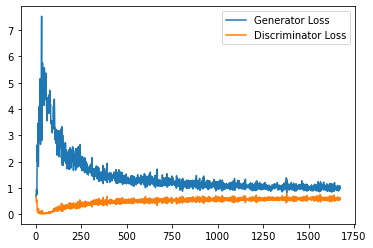

Step 34000: Generator loss: 1.0128972721099854, discriminator loss: 0.591985791862011


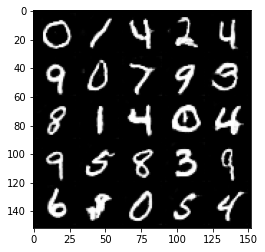

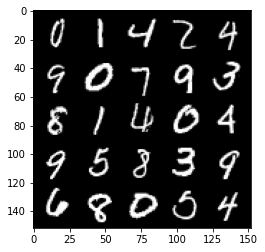

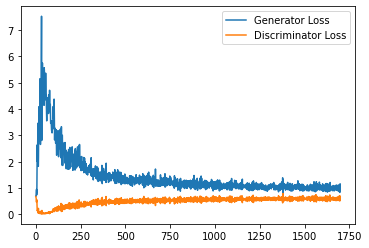

Step 34500: Generator loss: 1.0001884589195251, discriminator loss: 0.5864048921465874


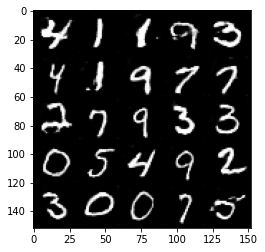

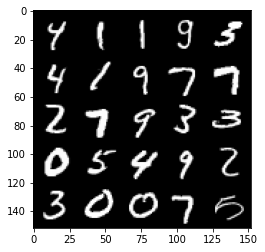

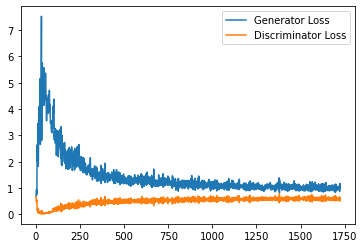

Step 35000: Generator loss: 1.0289869030714036, discriminator loss: 0.5935313193202019


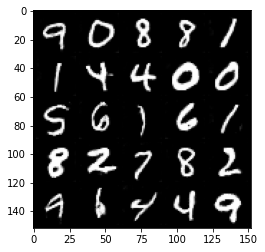

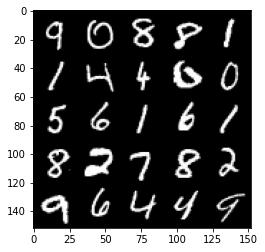

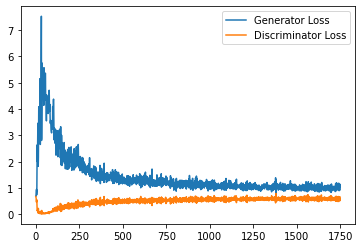

Step 35500: Generator loss: 1.04085458278656, discriminator loss: 0.5903096411824227


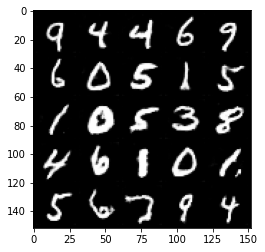

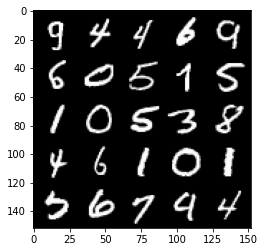

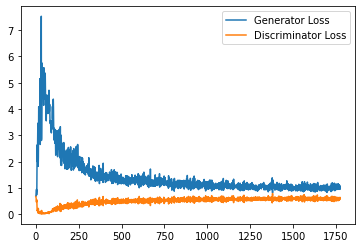

Step 36000: Generator loss: 1.005761097073555, discriminator loss: 0.5967734733819962


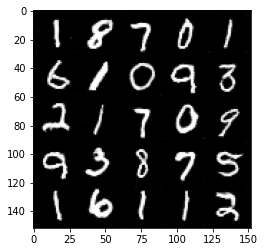

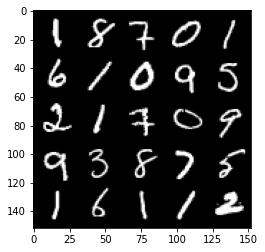

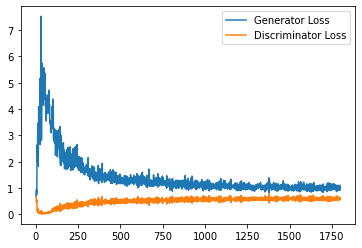

Step 36500: Generator loss: 1.0313449804782868, discriminator loss: 0.5929709932804108


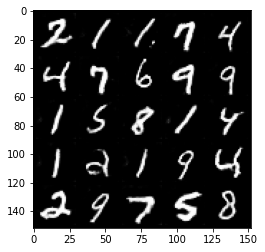

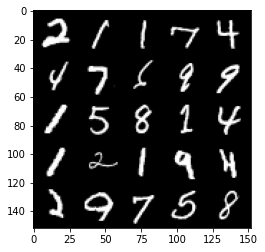

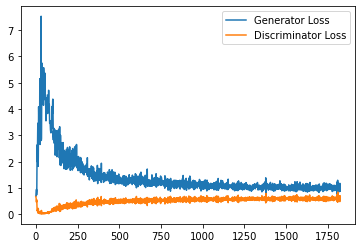

Step 37000: Generator loss: 0.9997874454259873, discriminator loss: 0.5876104036569595


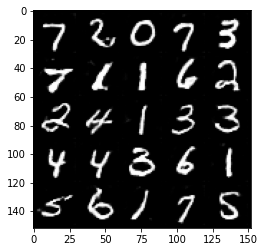

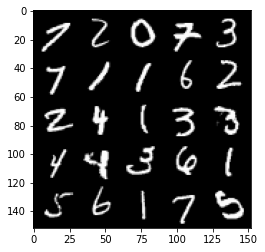

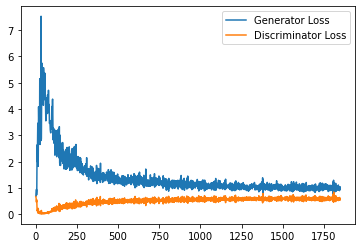

Step 37500: Generator loss: 1.0228643095493317, discriminator loss: 0.5906386695504189


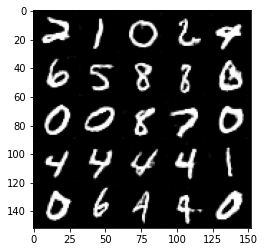

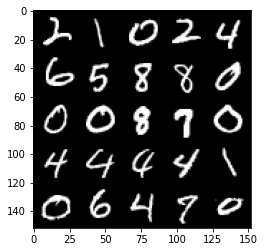

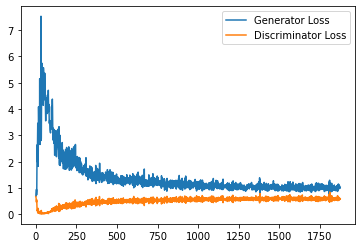

Step 38000: Generator loss: 1.040450200676918, discriminator loss: 0.5902279006242752


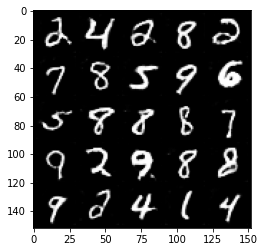

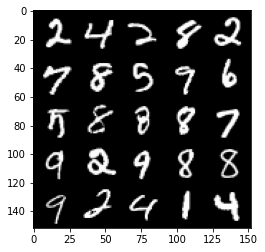

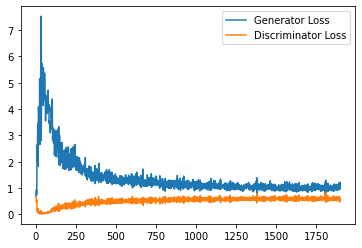

Step 38500: Generator loss: 1.0039717466831208, discriminator loss: 0.5961148364543915


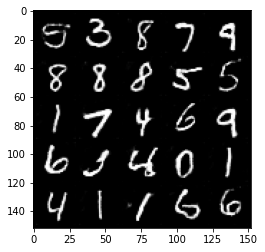

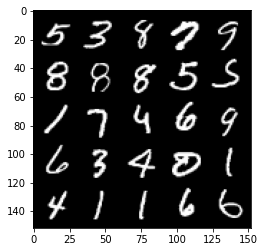

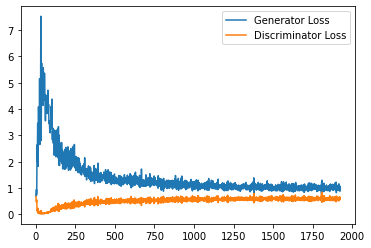

Step 39000: Generator loss: 1.0060286338329316, discriminator loss: 0.58773388671875


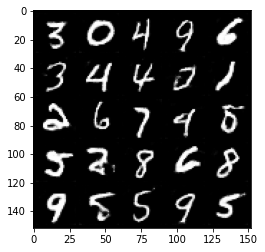

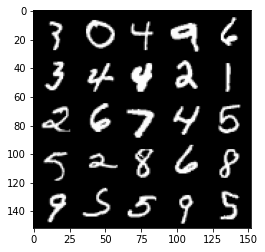

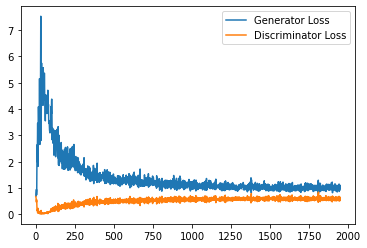

Step 39500: Generator loss: 1.0147183979749679, discriminator loss: 0.5894680134654046


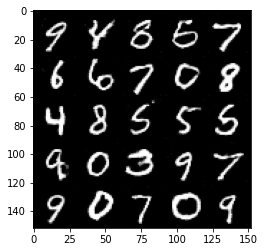

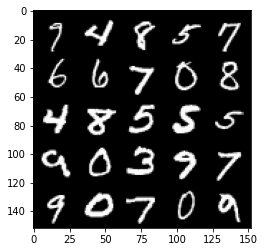

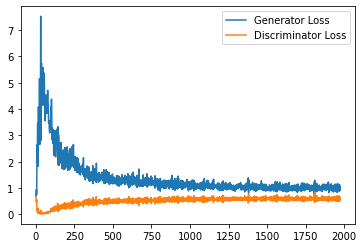

Step 40000: Generator loss: 1.0120654765367507, discriminator loss: 0.5853300722837448


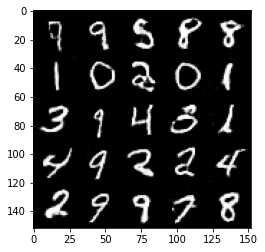

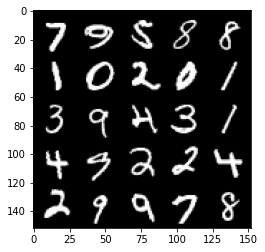

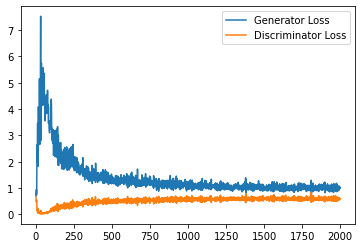

Step 40500: Generator loss: 1.048301136136055, discriminator loss: 0.5842231028676033


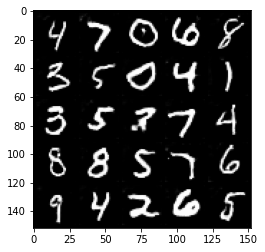

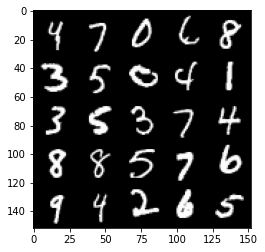

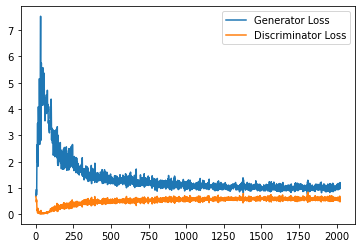

Step 41000: Generator loss: 1.020502245426178, discriminator loss: 0.5864426583051682


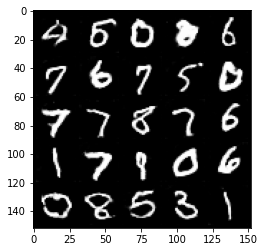

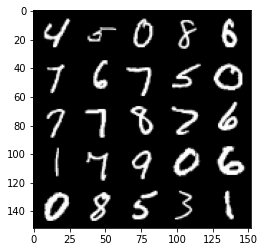

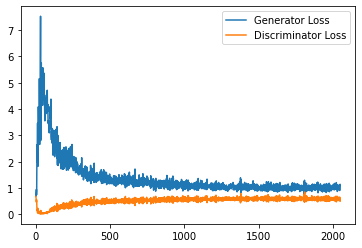

Step 41500: Generator loss: 1.0186471152305603, discriminator loss: 0.5856345232725143


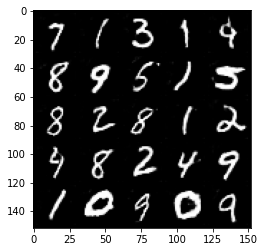

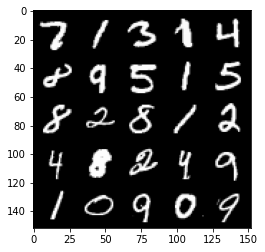

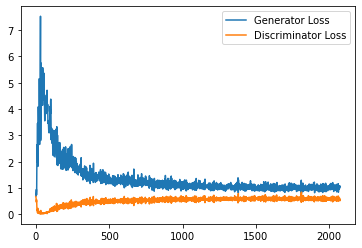

Step 42000: Generator loss: 0.997396719455719, discriminator loss: 0.5928247779011726


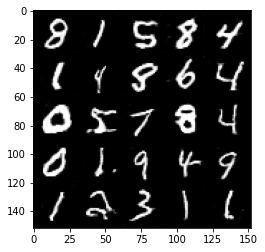

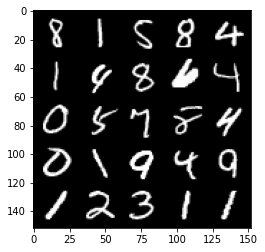

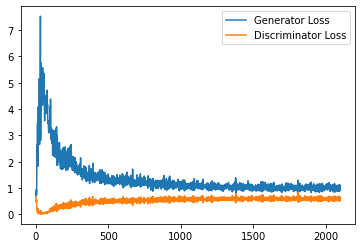

Step 42500: Generator loss: 1.0185172733068466, discriminator loss: 0.5861452196240425


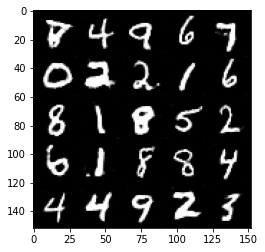

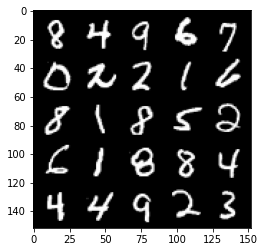

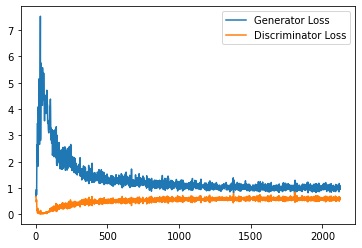

Step 43000: Generator loss: 1.025958300113678, discriminator loss: 0.5891152663230896


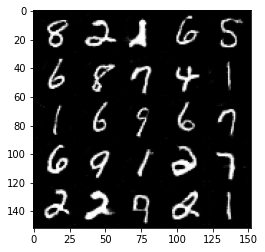

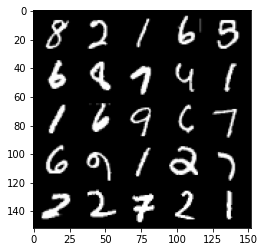

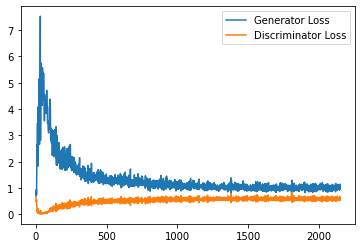

Step 43500: Generator loss: 1.0207877805233, discriminator loss: 0.5853089619874954


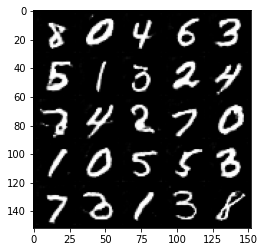

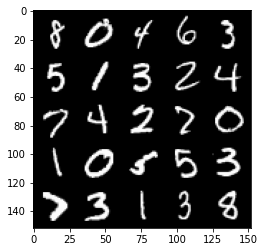

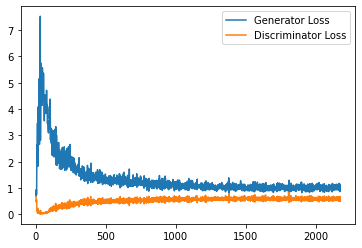

Step 44000: Generator loss: 1.022764127254486, discriminator loss: 0.5783702680468559


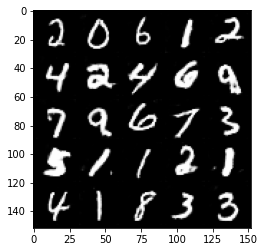

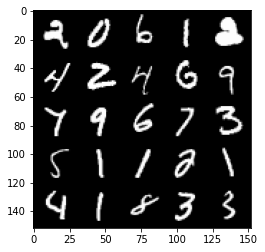

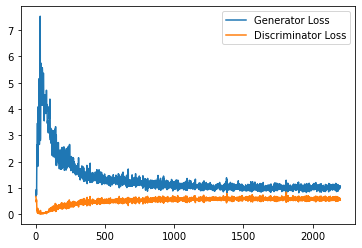

Step 44500: Generator loss: 1.0299904519319534, discriminator loss: 0.5863190061450004


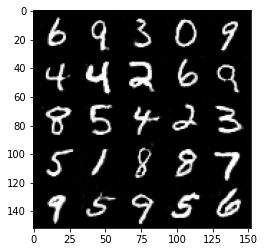

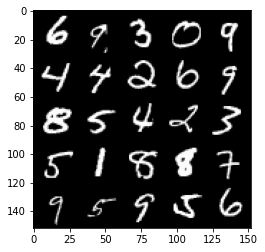

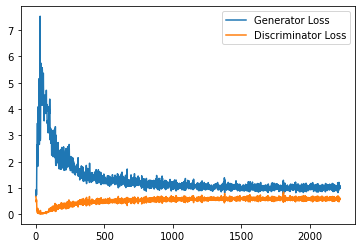

Step 45000: Generator loss: 1.0078925404548644, discriminator loss: 0.5792070187330246


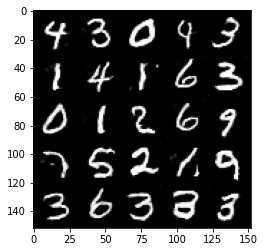

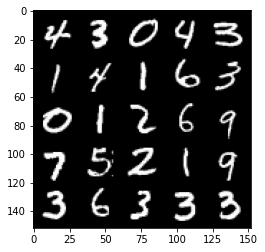

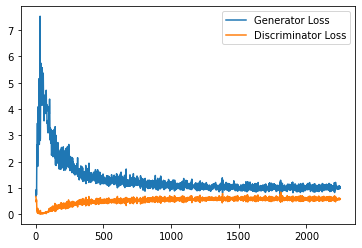

Step 45500: Generator loss: 1.0557424850463868, discriminator loss: 0.5798968393206596


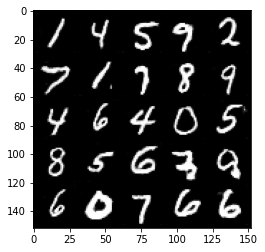

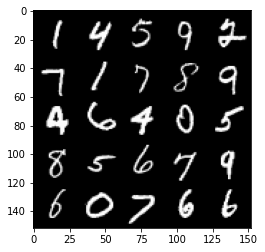

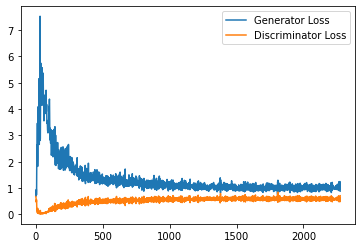

Step 46000: Generator loss: 1.0392393577098846, discriminator loss: 0.581238963007927


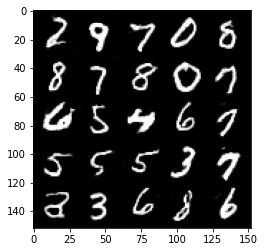

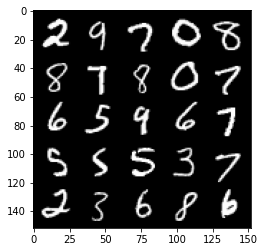

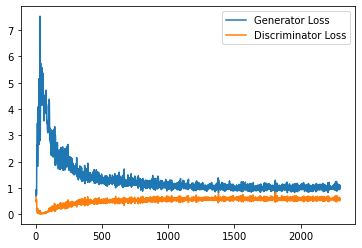

Step 46500: Generator loss: 1.029627535700798, discriminator loss: 0.5823278240561486


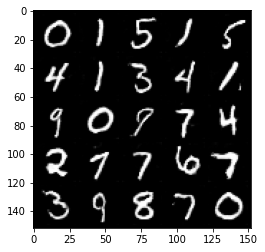

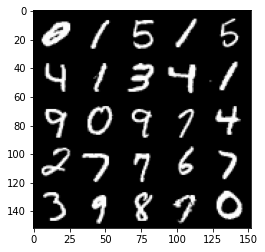

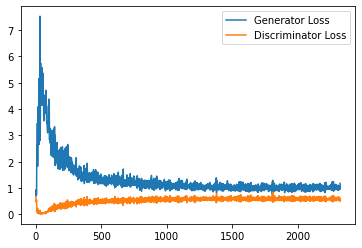

Step 47000: Generator loss: 1.0501897103786468, discriminator loss: 0.5850065630674363


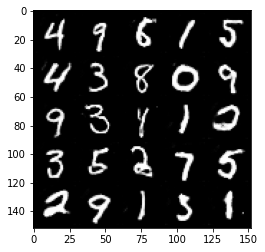

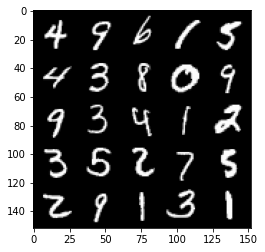

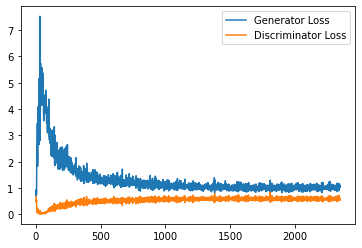

Step 47500: Generator loss: 1.0305911656618119, discriminator loss: 0.5817827731370926


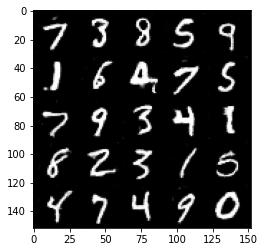

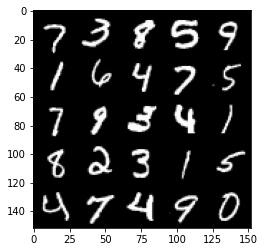

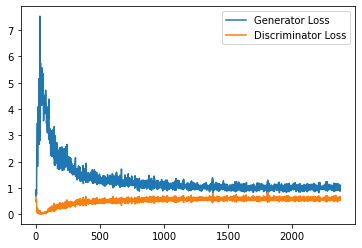

Step 48000: Generator loss: 1.0520775368213653, discriminator loss: 0.5768018447160721


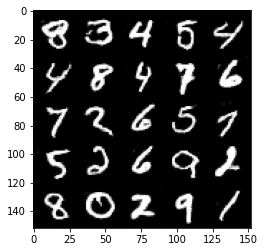

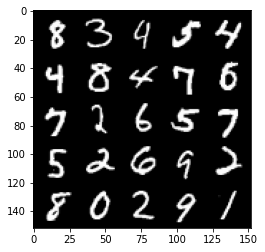

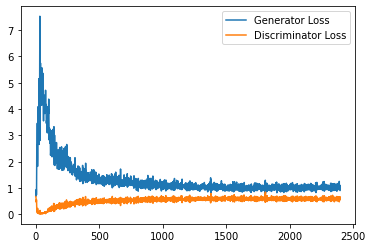

Step 48500: Generator loss: 1.028836606144905, discriminator loss: 0.5763164877295494


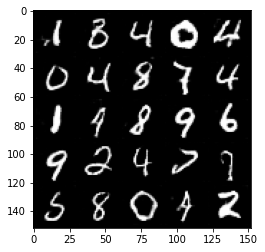

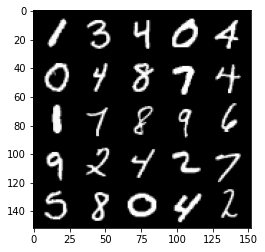

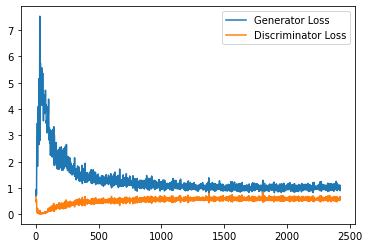

Step 49000: Generator loss: 1.0303535610437393, discriminator loss: 0.5767986596822738


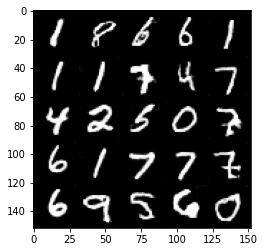

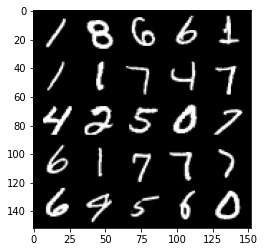

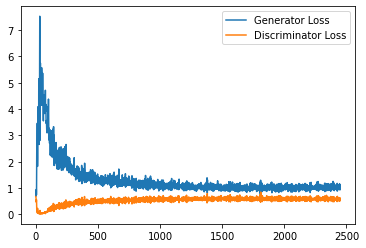

Step 49500: Generator loss: 1.053763053536415, discriminator loss: 0.5768758065104485


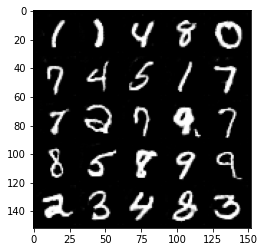

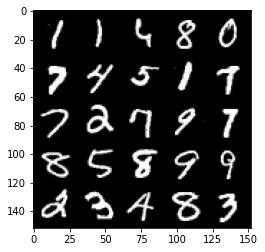

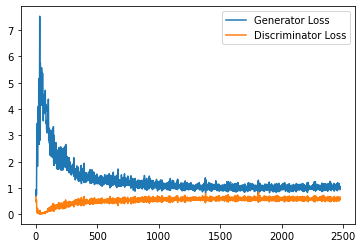

Step 50000: Generator loss: 1.053885529756546, discriminator loss: 0.5754438129663467


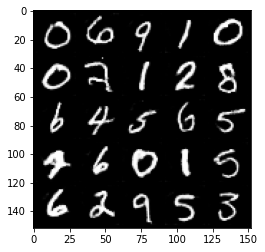

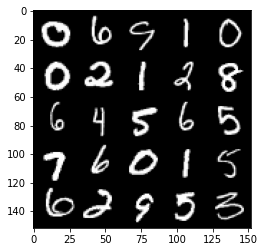

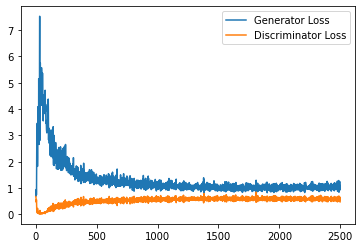

Step 50500: Generator loss: 1.0126876693964004, discriminator loss: 0.5822546270489692


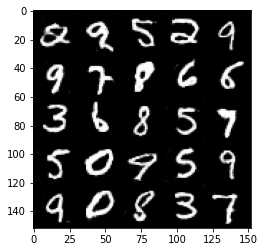

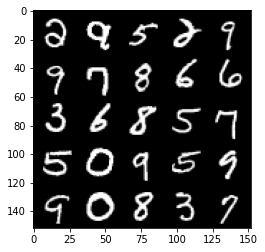

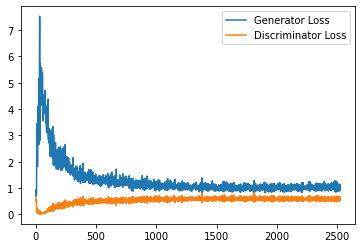

Step 51000: Generator loss: 1.0632282314300536, discriminator loss: 0.5726141115427017


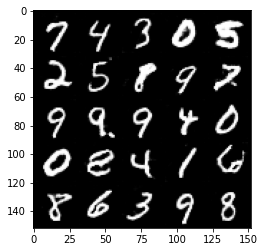

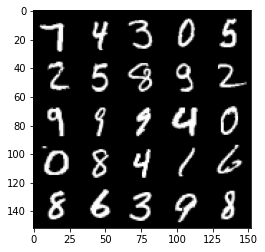

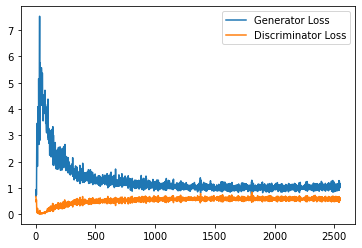

Step 51500: Generator loss: 1.0647509747743606, discriminator loss: 0.5713088384270668


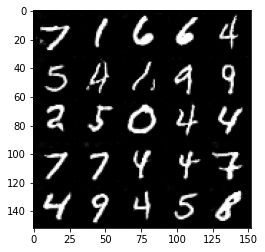

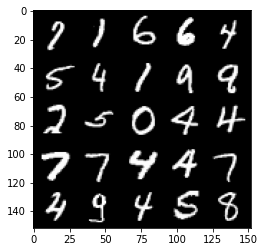

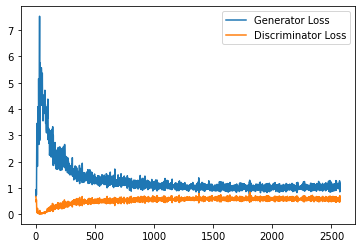

Step 52000: Generator loss: 1.04521992790699, discriminator loss: 0.5708740845322609


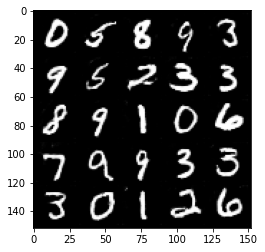

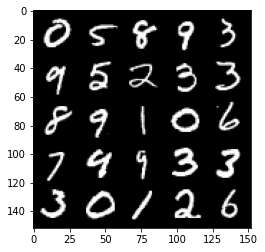

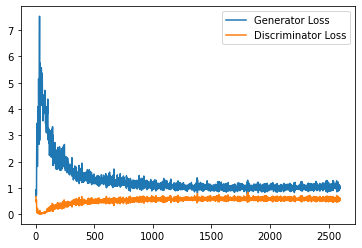

Step 52500: Generator loss: 1.0586198943853378, discriminator loss: 0.5662034893035889


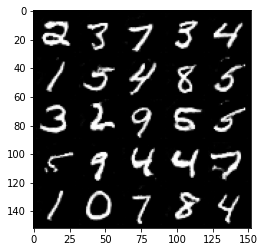

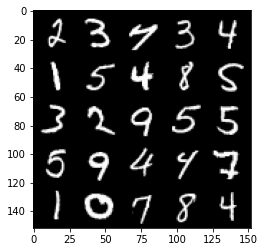

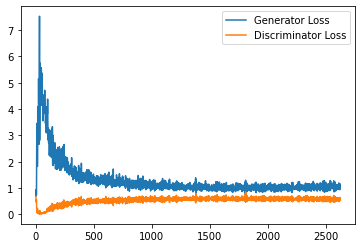

Step 53000: Generator loss: 1.0819917237758636, discriminator loss: 0.5652703975439072


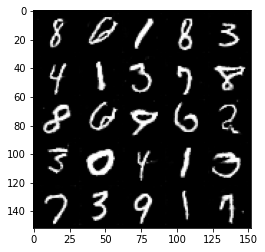

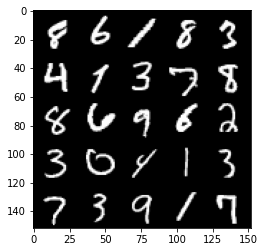

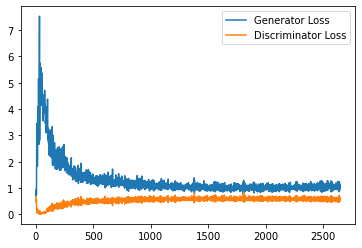

Step 53500: Generator loss: 1.07009803545475, discriminator loss: 0.5610531132817268


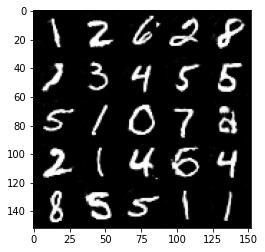

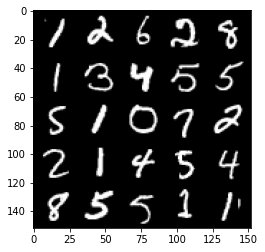

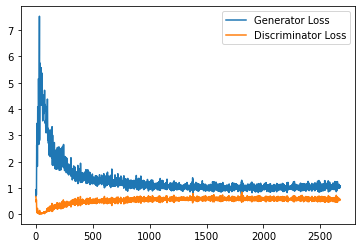

Step 54000: Generator loss: 1.060673716187477, discriminator loss: 0.5613904002308846


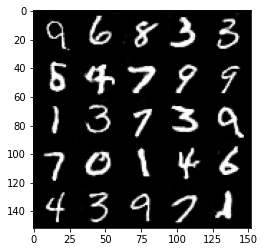

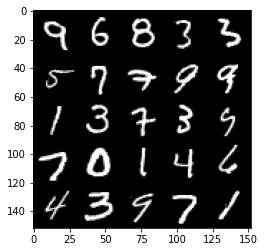

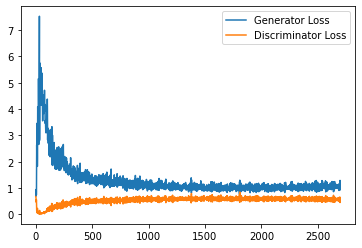

Step 54500: Generator loss: 1.0765166236162185, discriminator loss: 0.5681699461340904


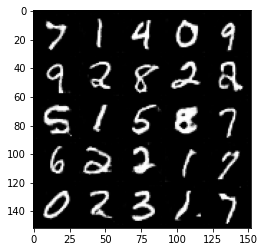

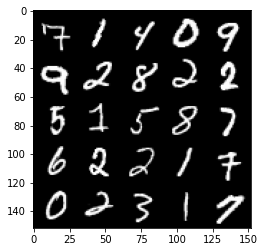

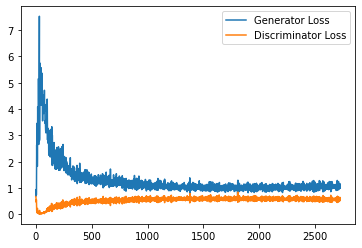

Step 55000: Generator loss: 1.0973346259593963, discriminator loss: 0.5661209861636162


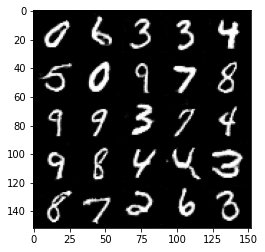

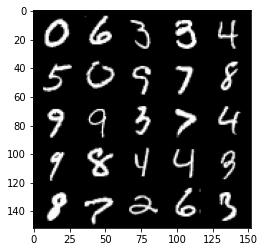

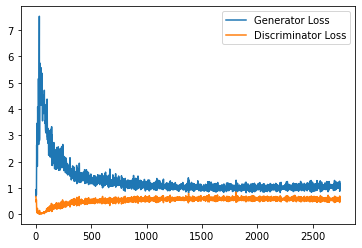

Step 55500: Generator loss: 1.0795410121679305, discriminator loss: 0.5674207436442376


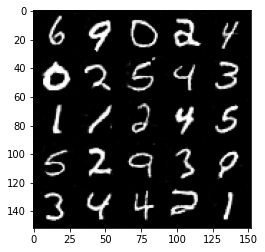

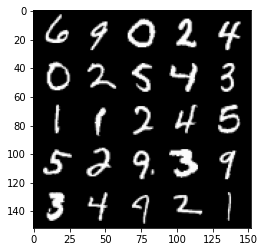

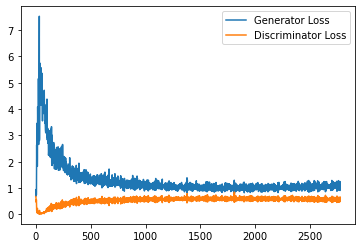

Step 56000: Generator loss: 1.0688640711307527, discriminator loss: 0.5628509024977684


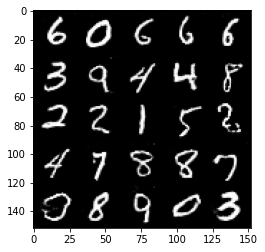

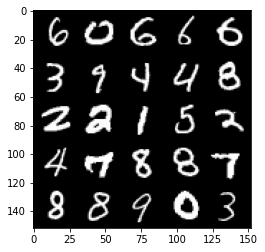

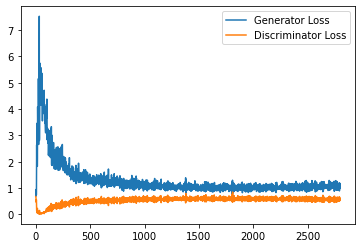

Step 56500: Generator loss: 1.0918920686244964, discriminator loss: 0.5568954132199287


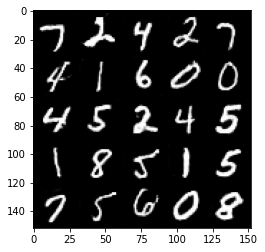

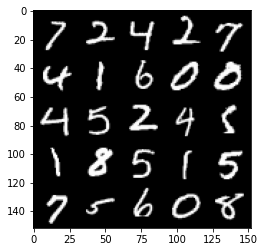

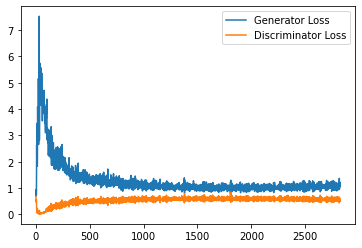

Step 57000: Generator loss: 1.097174810528755, discriminator loss: 0.5624201942682266


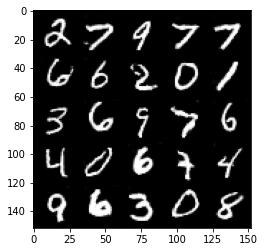

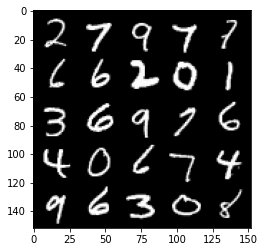

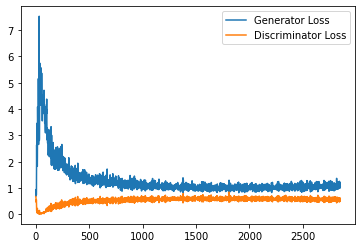

Step 57500: Generator loss: 1.093592587351799, discriminator loss: 0.5552831473946571


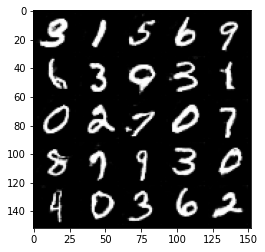

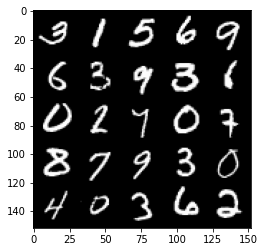

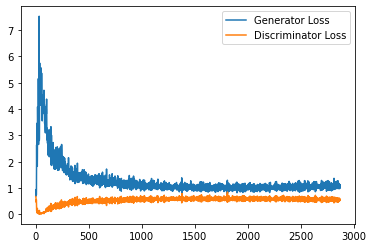

Step 58000: Generator loss: 1.099930532336235, discriminator loss: 0.5549172292947769


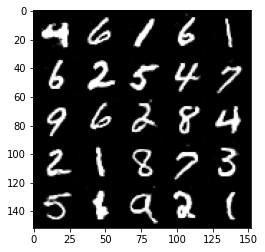

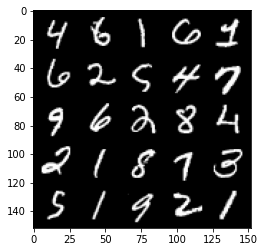

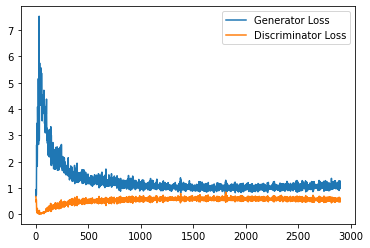

Step 58500: Generator loss: 1.1152252222299577, discriminator loss: 0.5584859563112259


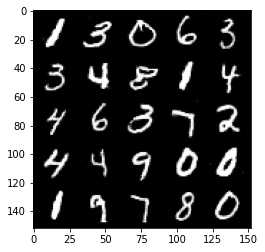

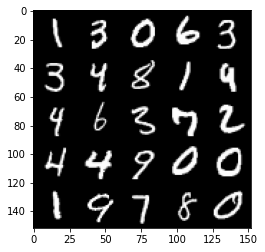

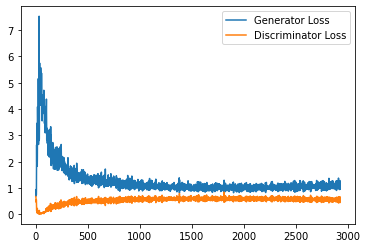

Step 59000: Generator loss: 1.100649780869484, discriminator loss: 0.5529102156758309


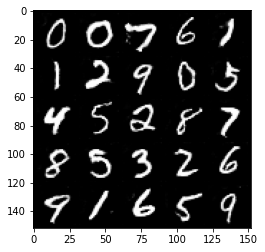

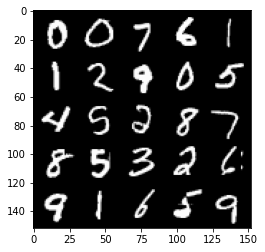

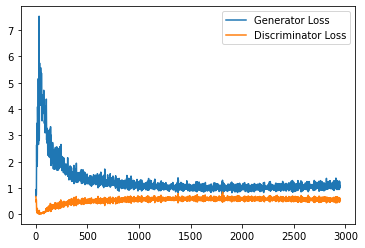

Step 59500: Generator loss: 1.0849349851608276, discriminator loss: 0.557359027326107


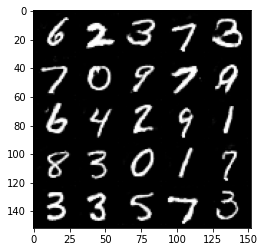

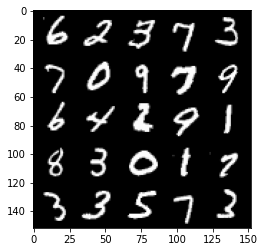

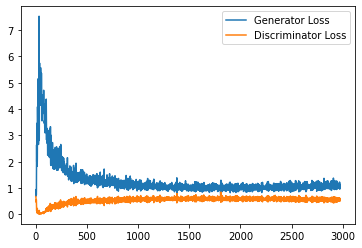

Step 60000: Generator loss: 1.1056622378826142, discriminator loss: 0.5550950757265091


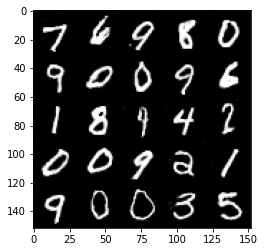

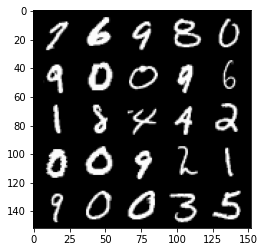

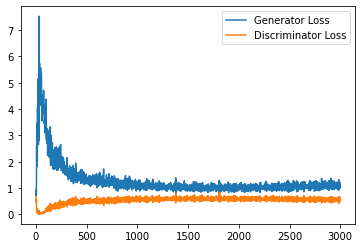

Step 60500: Generator loss: 1.113052235007286, discriminator loss: 0.5568032035827637


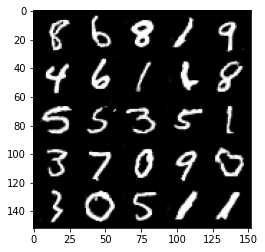

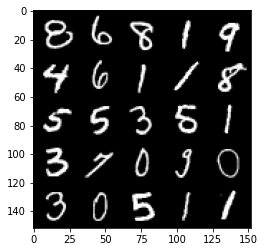

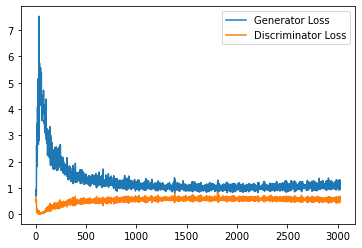

Step 61000: Generator loss: 1.121084655880928, discriminator loss: 0.5478785108327866


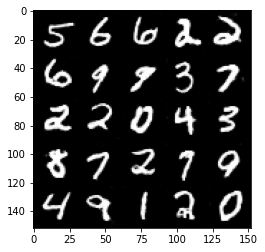

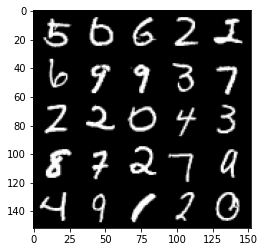

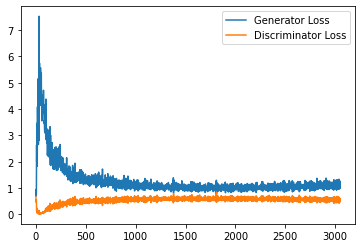

Step 61500: Generator loss: 1.0962445216178893, discriminator loss: 0.5520121070146561


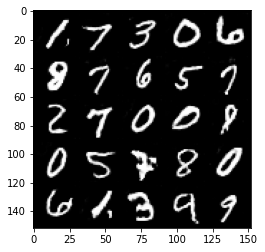

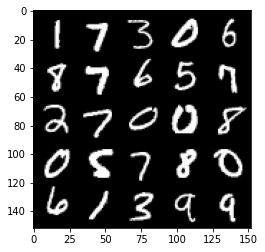

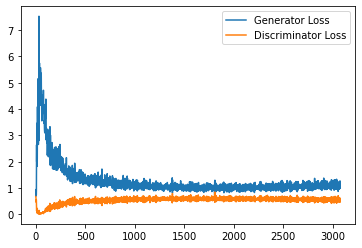

Step 62000: Generator loss: 1.1339405410289765, discriminator loss: 0.5501460441946984


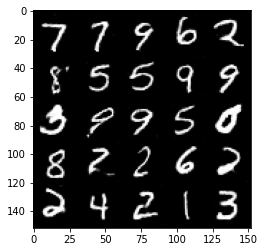

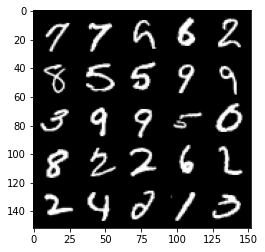

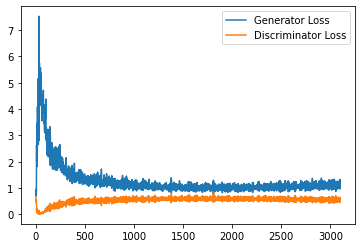

Step 62500: Generator loss: 1.1040284603834152, discriminator loss: 0.5543946173191071


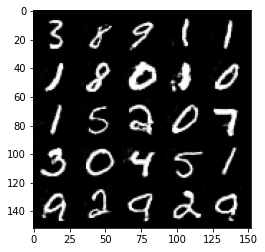

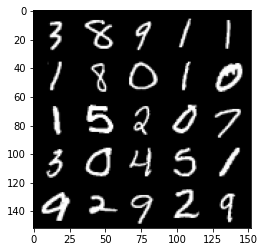

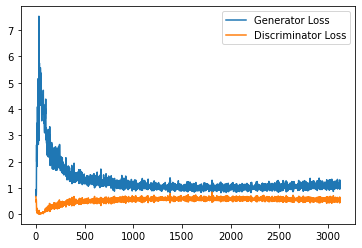

Step 63000: Generator loss: 1.1162229412794114, discriminator loss: 0.5549504200816154


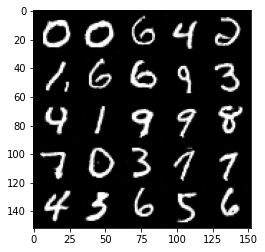

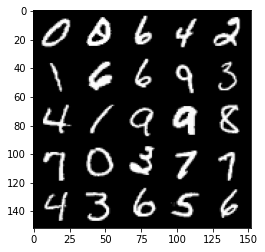

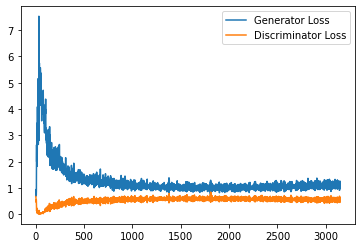

Step 63500: Generator loss: 1.1178272957801818, discriminator loss: 0.5472977135181427


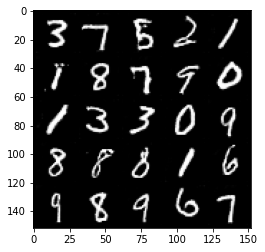

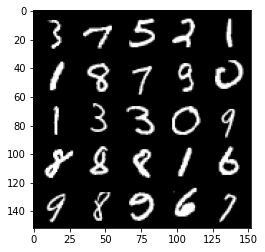

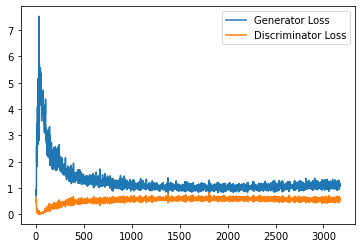

Step 64000: Generator loss: 1.0923876603841782, discriminator loss: 0.549268228828907


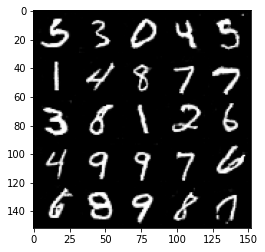

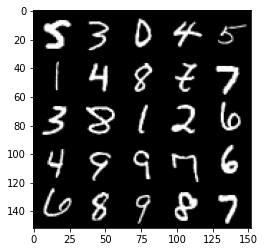

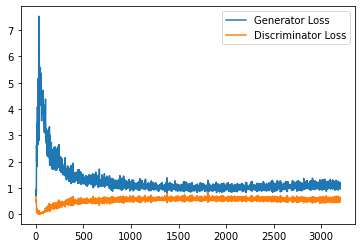

Step 64500: Generator loss: 1.1258161034584044, discriminator loss: 0.5497719367146492


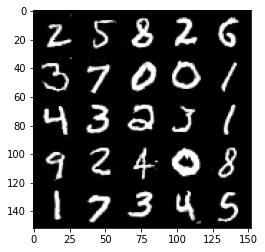

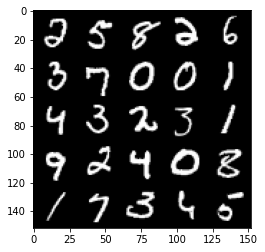

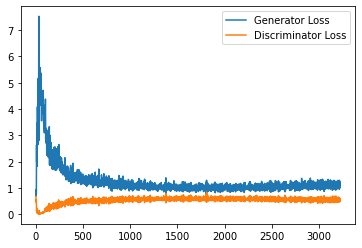

Step 65000: Generator loss: 1.1198049277067184, discriminator loss: 0.5523408831357955


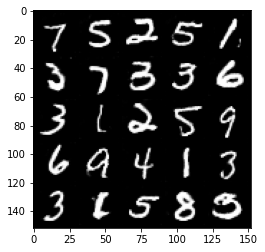

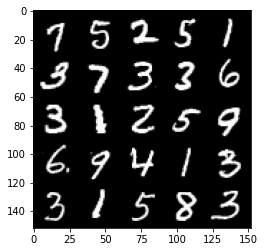

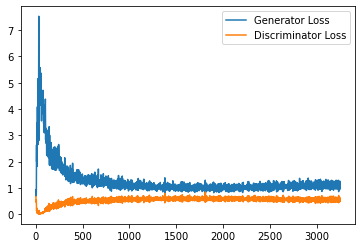

Step 65500: Generator loss: 1.1237831103801728, discriminator loss: 0.5540316227674484


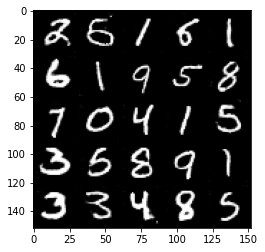

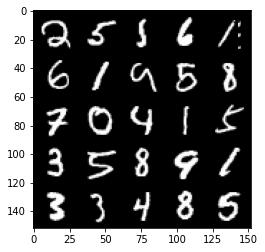

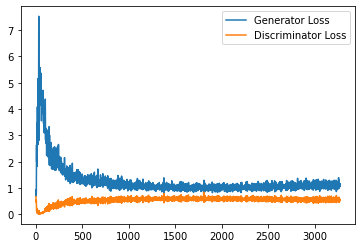

Step 66000: Generator loss: 1.1195249959230422, discriminator loss: 0.5484938846826554


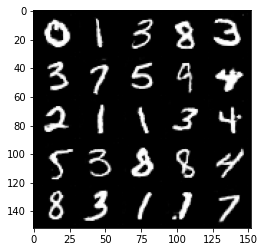

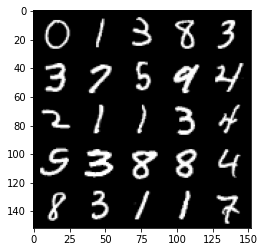

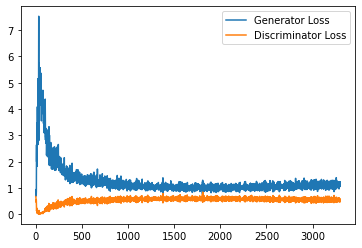

Step 66500: Generator loss: 1.1310027496814727, discriminator loss: 0.5589910434484482


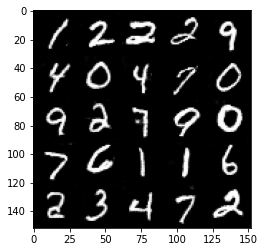

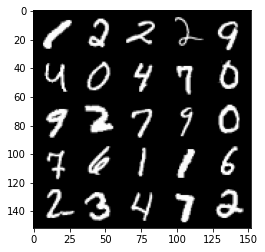

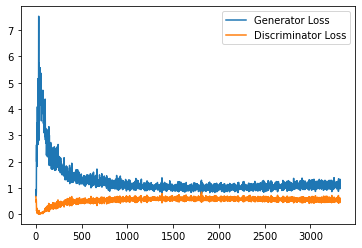

Step 67000: Generator loss: 1.0905025166273117, discriminator loss: 0.551575033068657


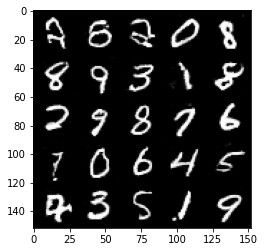

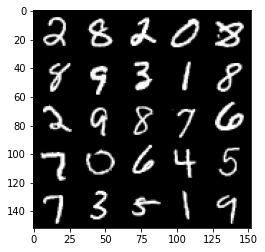

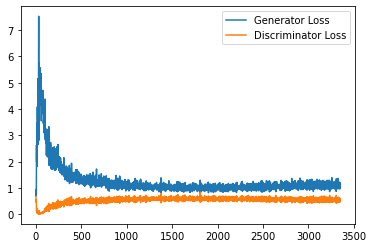

Step 67500: Generator loss: 1.1089235872030259, discriminator loss: 0.5486197257041932


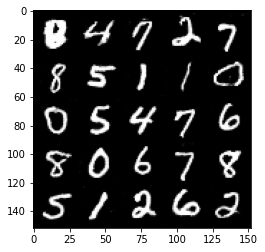

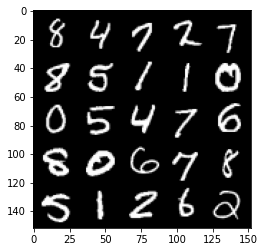

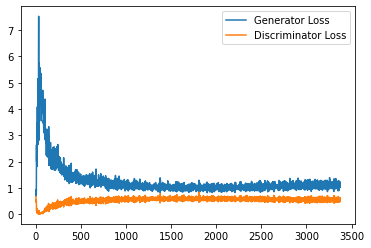

Step 68000: Generator loss: 1.1423272563219071, discriminator loss: 0.5436763560175896


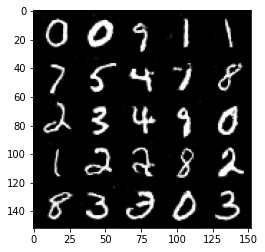

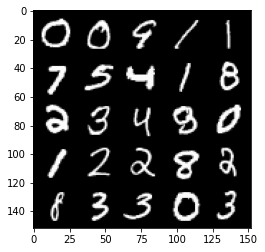

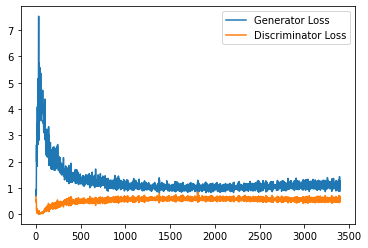

Step 68500: Generator loss: 1.1105660863518716, discriminator loss: 0.5596214956045151


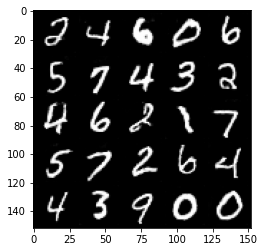

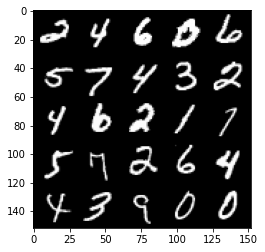

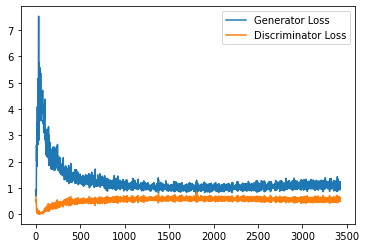

Step 69000: Generator loss: 1.135240914106369, discriminator loss: 0.547508242726326


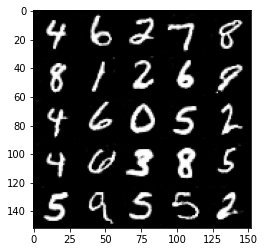

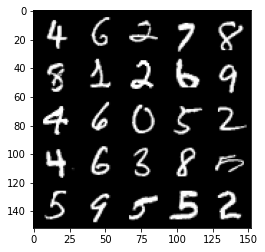

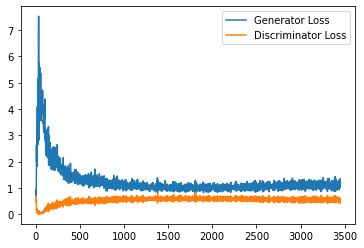

Step 69500: Generator loss: 1.1112915674448014, discriminator loss: 0.5603198323845864


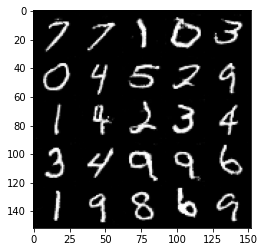

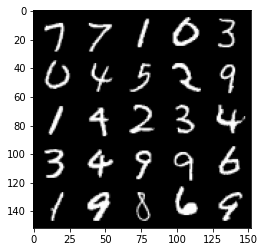

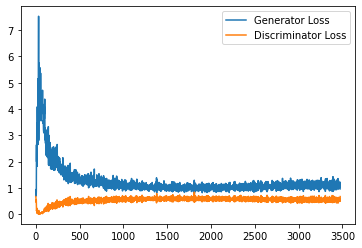

Step 70000: Generator loss: 1.1283702521324157, discriminator loss: 0.5448322383165359


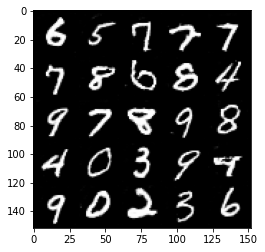

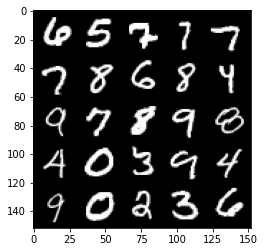

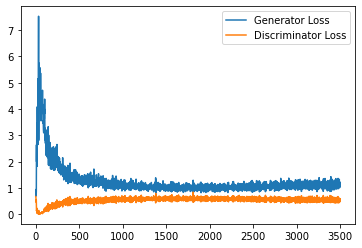

Step 70500: Generator loss: 1.1171610591411592, discriminator loss: 0.5447824100852012


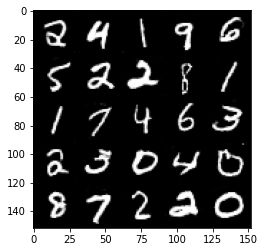

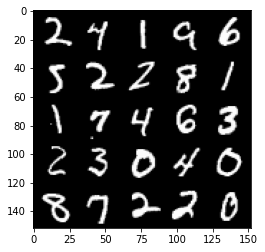

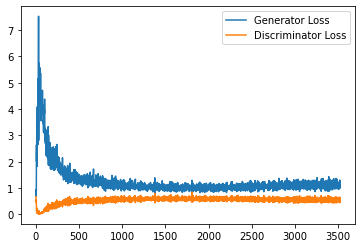

Step 71000: Generator loss: 1.1213686239719391, discriminator loss: 0.5537727953791618


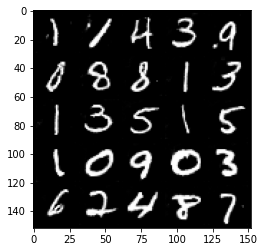

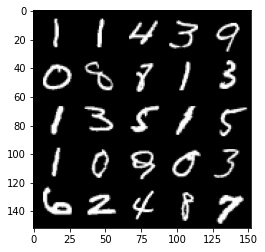

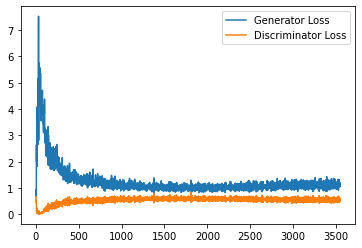

Step 71500: Generator loss: 1.1339074898958206, discriminator loss: 0.5491958186626434


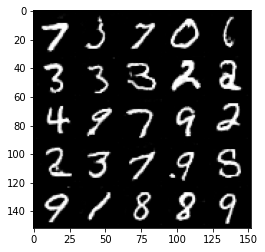

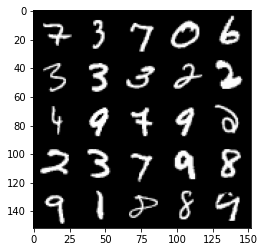

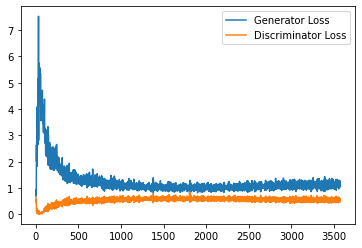

Step 72000: Generator loss: 1.143954489827156, discriminator loss: 0.5629514155983925


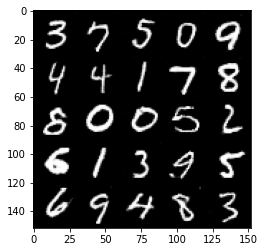

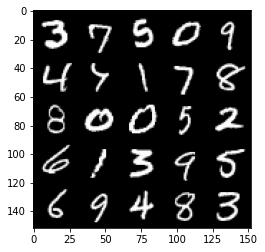

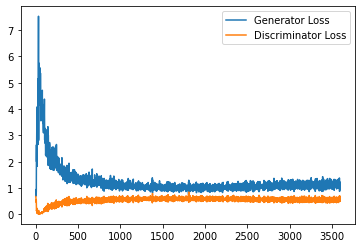

Step 72500: Generator loss: 1.1354541494846344, discriminator loss: 0.5502922495007515


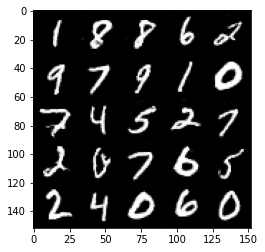

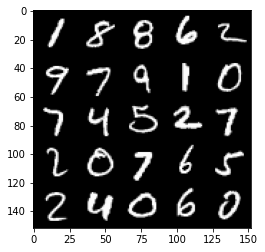

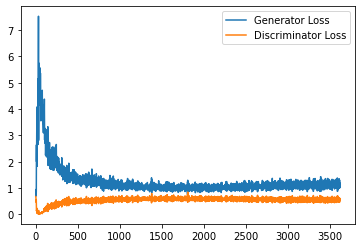

Step 73000: Generator loss: 1.1236877360343933, discriminator loss: 0.5485209974050522


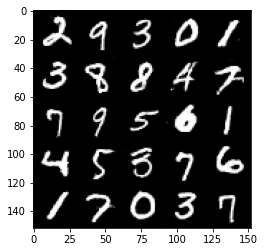

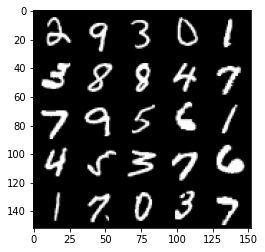

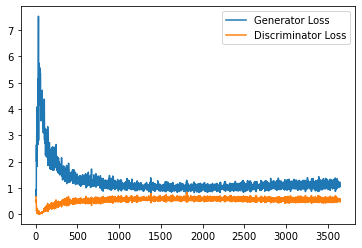

Step 73500: Generator loss: 1.1267338783740997, discriminator loss: 0.5482172192931175


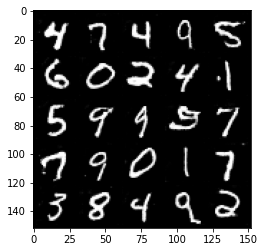

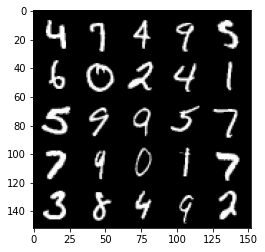

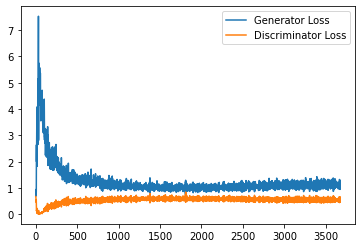

Step 74000: Generator loss: 1.122139899969101, discriminator loss: 0.5511609017252922


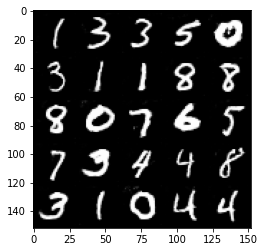

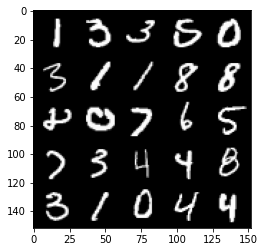

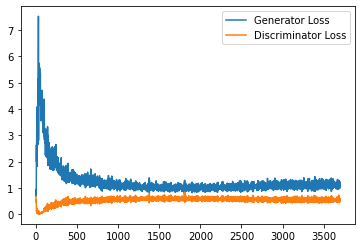

Step 74500: Generator loss: 1.1310811429023742, discriminator loss: 0.5481037252545357


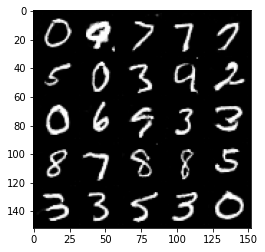

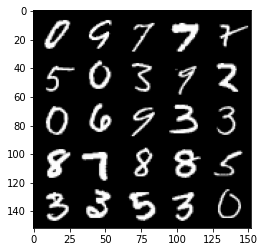

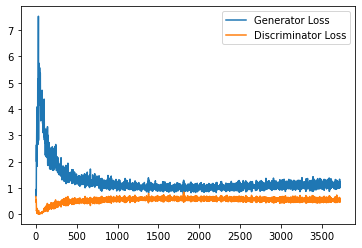

Step 75000: Generator loss: 1.1298586741685868, discriminator loss: 0.55915565097332


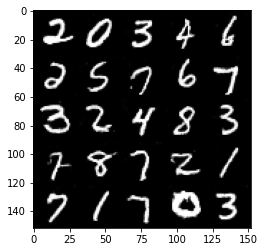

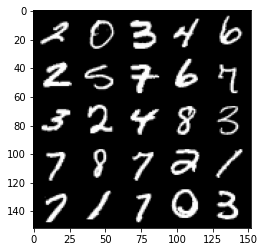

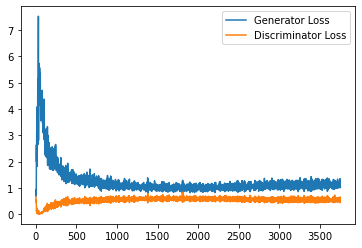

Step 75500: Generator loss: 1.1456340210437774, discriminator loss: 0.5520227519273758


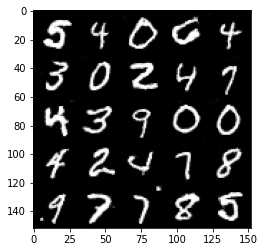

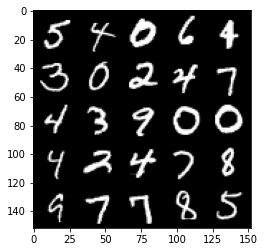

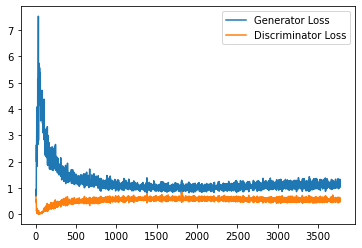

Step 76000: Generator loss: 1.1308953255414962, discriminator loss: 0.5505415457487106


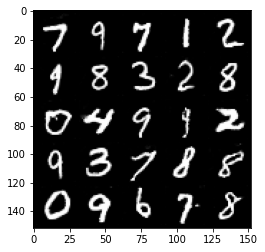

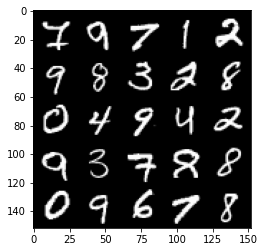

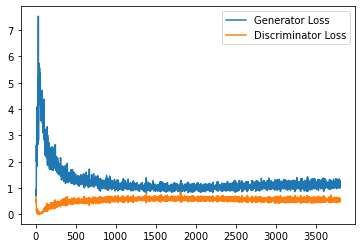

Step 76500: Generator loss: 1.1324832817316055, discriminator loss: 0.5541750687360764


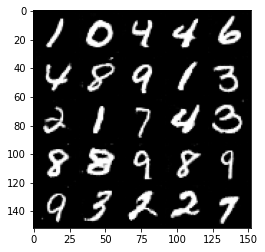

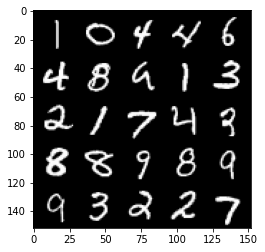

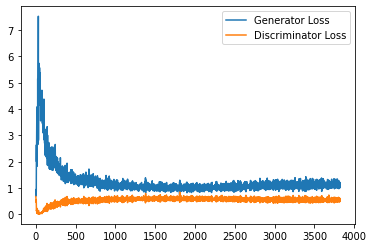

Step 77000: Generator loss: 1.1356103471517562, discriminator loss: 0.5479444890022278


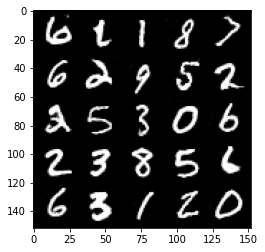

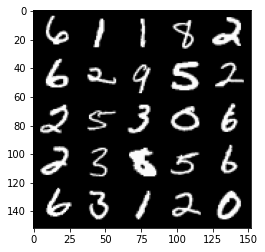

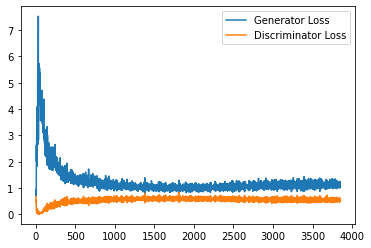

Step 77500: Generator loss: 1.126261148571968, discriminator loss: 0.5570831028223038


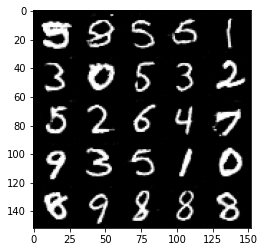

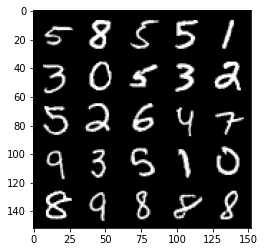

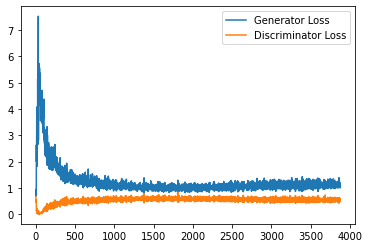

Step 78000: Generator loss: 1.1436218136548997, discriminator loss: 0.5494731112718582


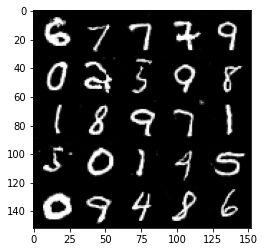

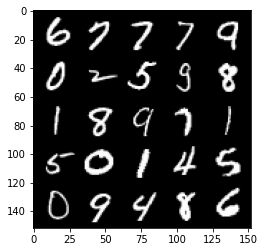

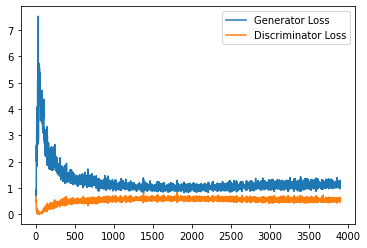

Step 78500: Generator loss: 1.1327811207771301, discriminator loss: 0.5491413252949715


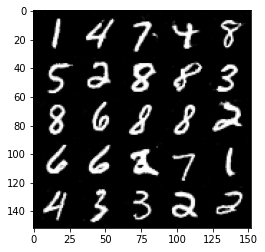

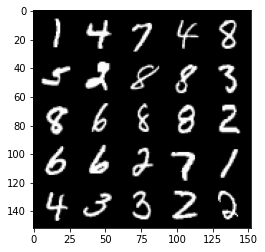

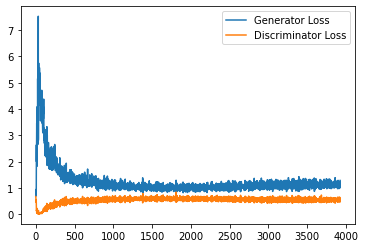

Step 79000: Generator loss: 1.1270080310106279, discriminator loss: 0.5521980020403862


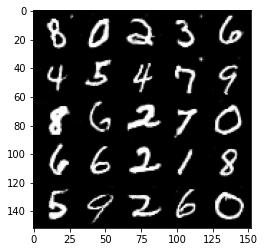

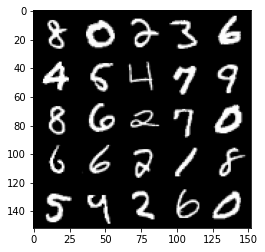

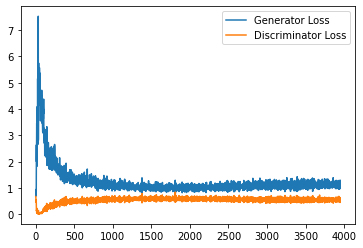

Step 79500: Generator loss: 1.123723137497902, discriminator loss: 0.5563260104060173


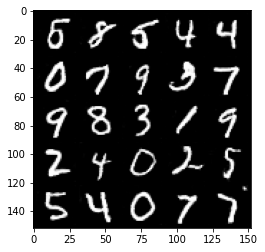

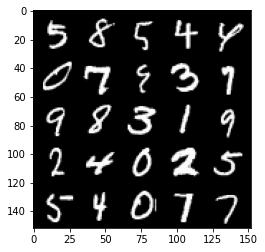

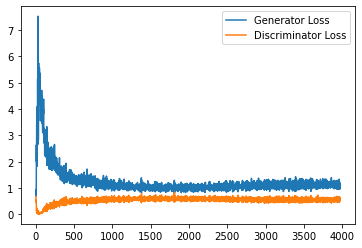

Step 80000: Generator loss: 1.1248781210184098, discriminator loss: 0.555977194428444


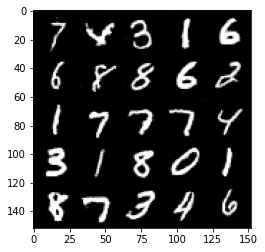

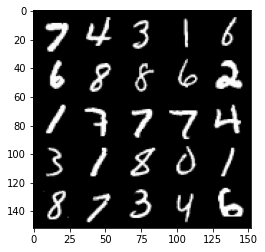

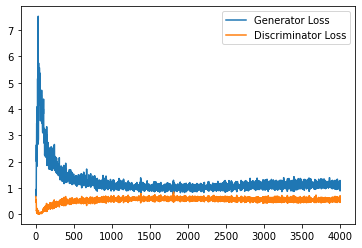

Step 80500: Generator loss: 1.1253926235437393, discriminator loss: 0.5493039565086365


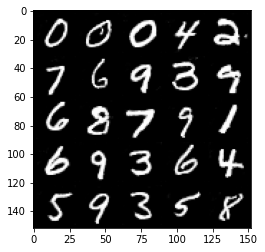

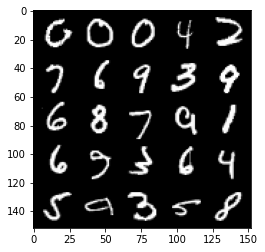

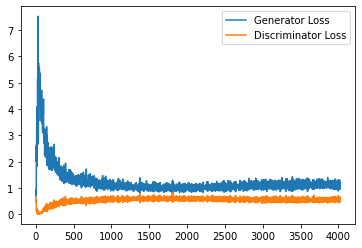

Step 81000: Generator loss: 1.1119788542985916, discriminator loss: 0.5579714789986611


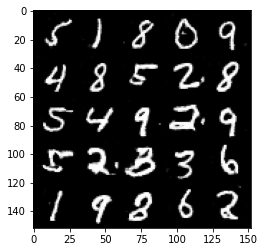

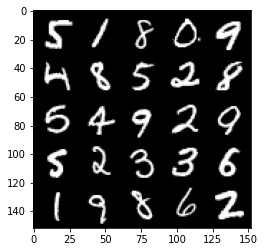

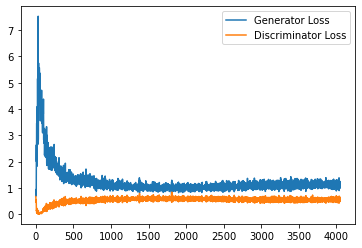

Step 81500: Generator loss: 1.169725608587265, discriminator loss: 0.5461091710925102


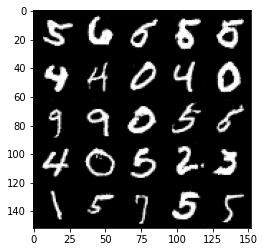

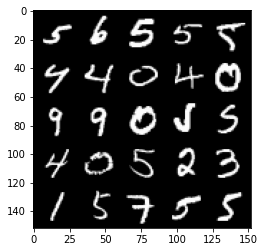

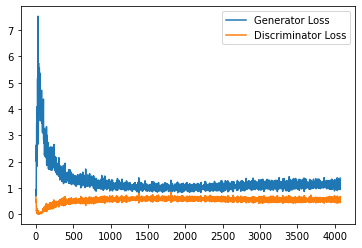

Step 82000: Generator loss: 1.1337298407554626, discriminator loss: 0.5571945568323136


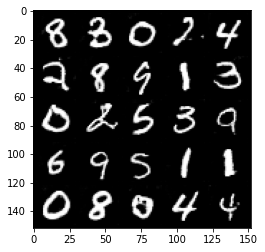

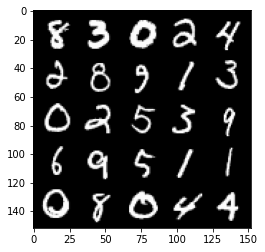

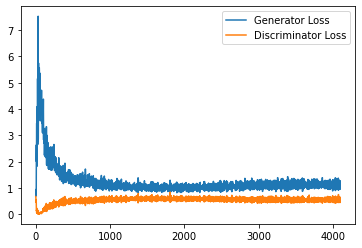

Step 82500: Generator loss: 1.1330081572532653, discriminator loss: 0.551123434484005


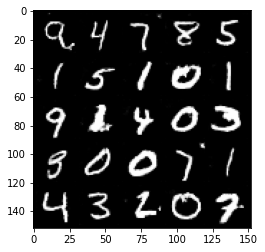

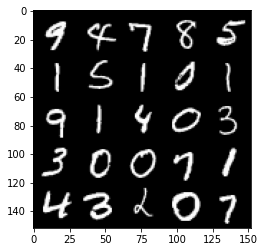

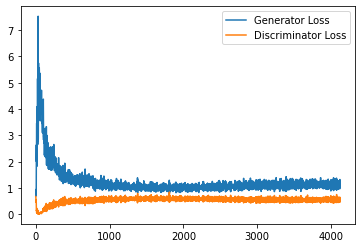

Step 83000: Generator loss: 1.1366201844215393, discriminator loss: 0.5508477735519409


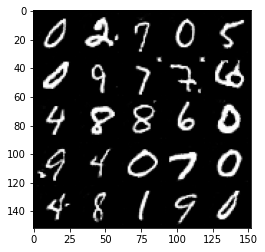

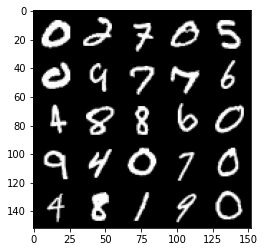

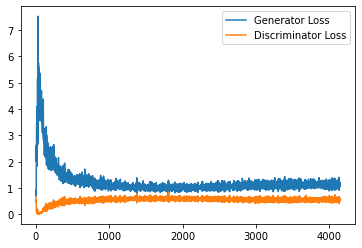

Step 83500: Generator loss: 1.123045659661293, discriminator loss: 0.5551109837293625


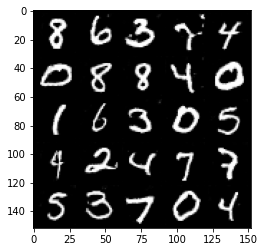

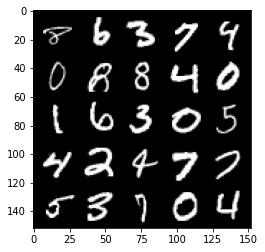

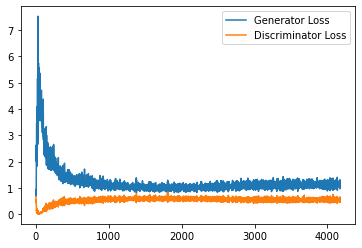

Step 84000: Generator loss: 1.149141533613205, discriminator loss: 0.5478748062252998


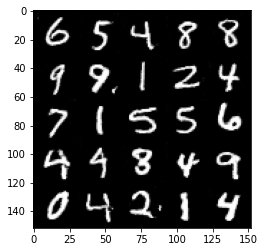

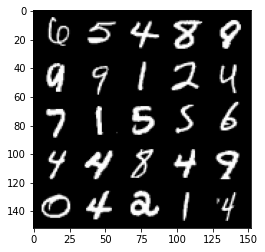

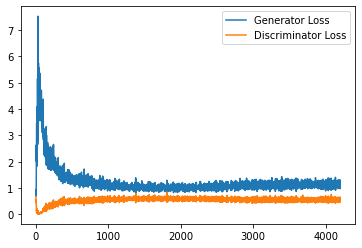

Step 84500: Generator loss: 1.139996924519539, discriminator loss: 0.5503107145428657


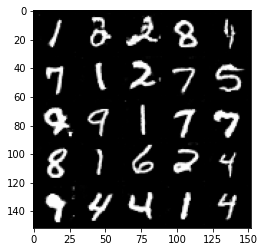

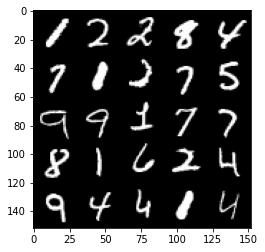

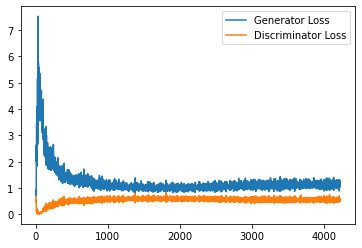

Step 85000: Generator loss: 1.131118952035904, discriminator loss: 0.5574727593660355


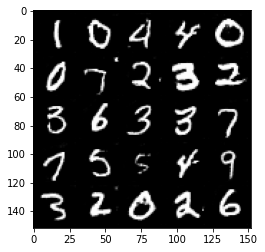

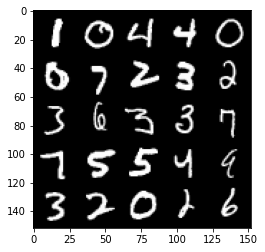

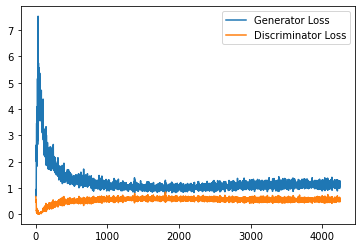

Step 85500: Generator loss: 1.1390555619001388, discriminator loss: 0.5490399368405342


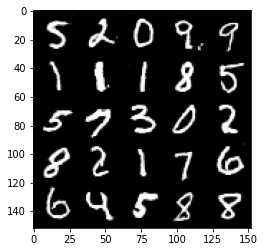

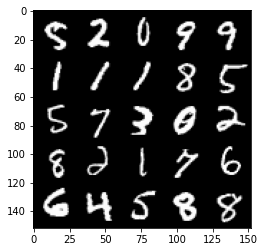

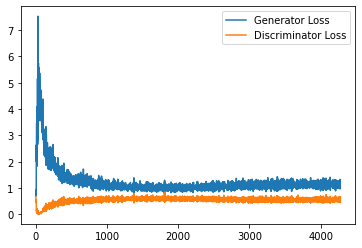

Step 86000: Generator loss: 1.1407732897996903, discriminator loss: 0.5531807376742363


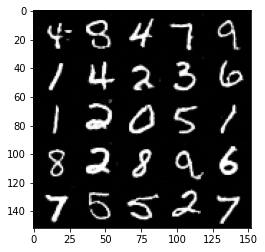

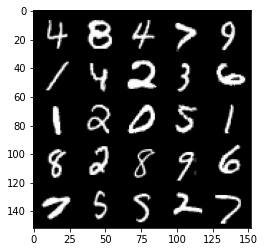

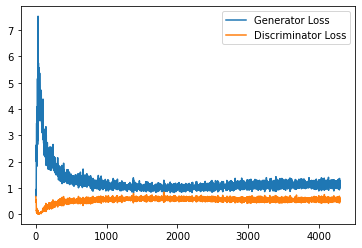

Step 86500: Generator loss: 1.121696732878685, discriminator loss: 0.5601847358942031


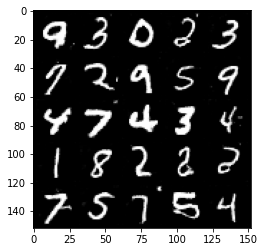

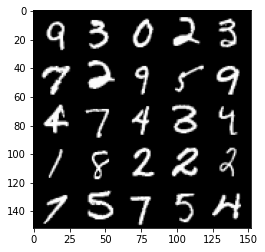

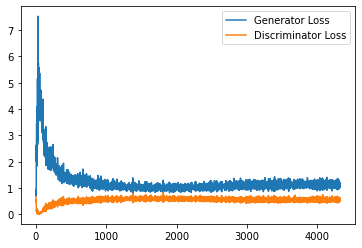

Step 87000: Generator loss: 1.1394600682258607, discriminator loss: 0.5522022632360458


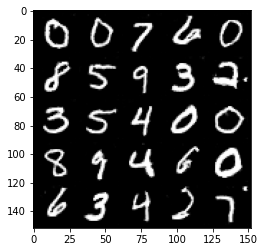

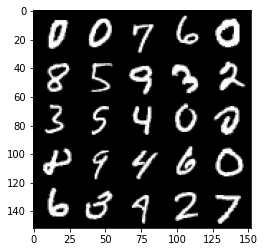

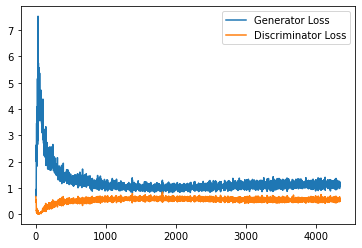

Step 87500: Generator loss: 1.1313445780277251, discriminator loss: 0.5527621178627015


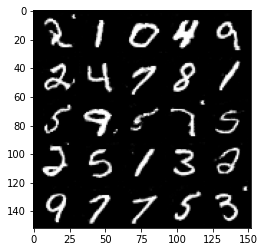

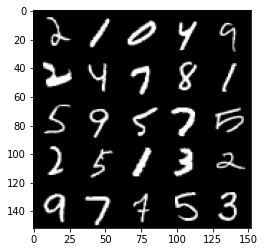

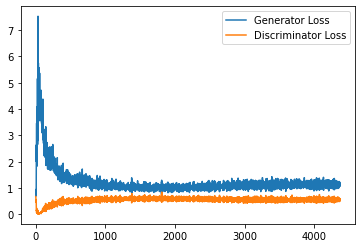

Step 88000: Generator loss: 1.1321956169605256, discriminator loss: 0.5562963410019874


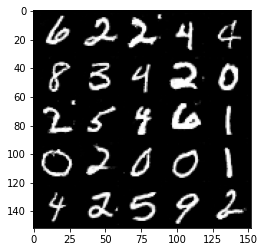

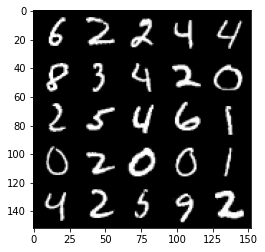

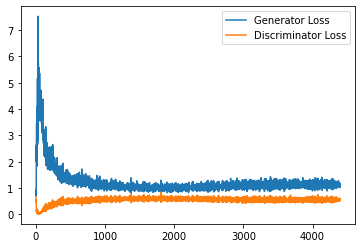

Step 88500: Generator loss: 1.1494305239915847, discriminator loss: 0.5525523427128792


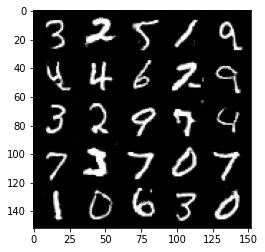

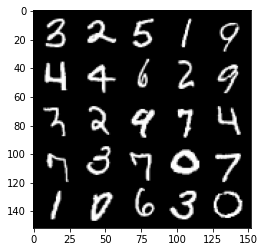

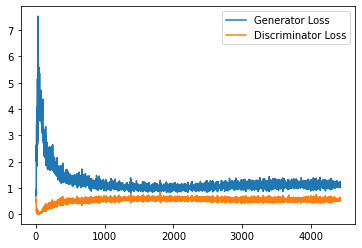

Step 89000: Generator loss: 1.1126280304193497, discriminator loss: 0.5613594132065773


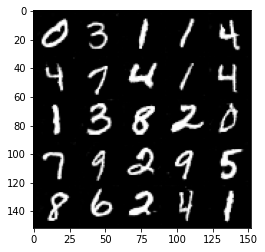

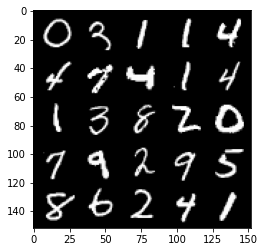

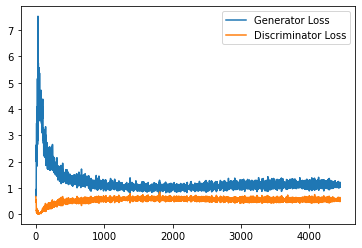

Step 89500: Generator loss: 1.1232546702623367, discriminator loss: 0.5602225069403648


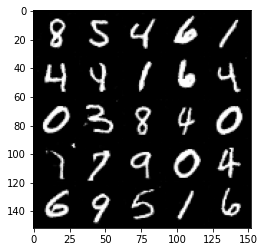

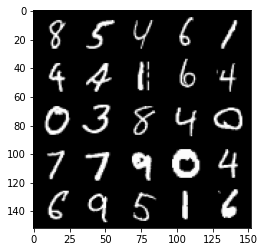

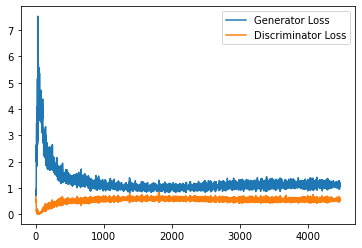

Step 90000: Generator loss: 1.1330222455263137, discriminator loss: 0.5570366007685661


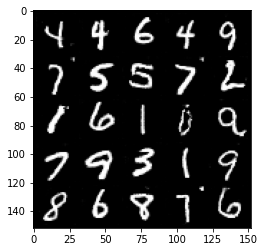

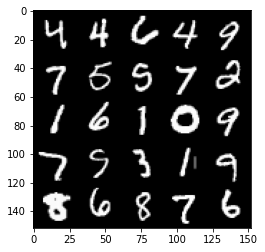

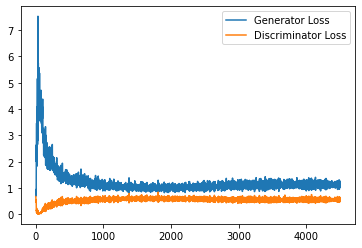

Step 90500: Generator loss: 1.1251732783317565, discriminator loss: 0.5587829354405404


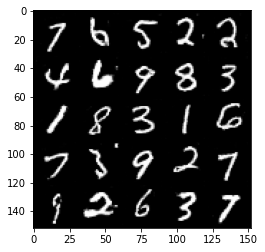

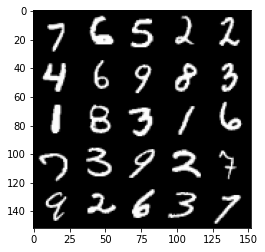

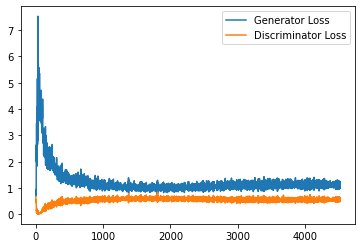

Step 91000: Generator loss: 1.1255044835805892, discriminator loss: 0.5596061673164368


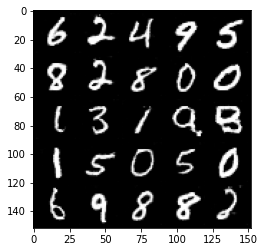

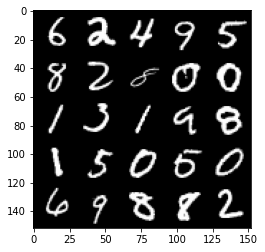

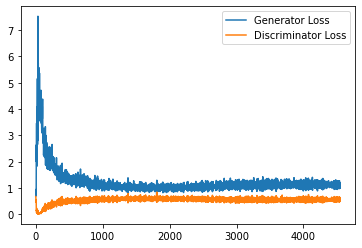

Step 91500: Generator loss: 1.1327507557868957, discriminator loss: 0.5534983240365982


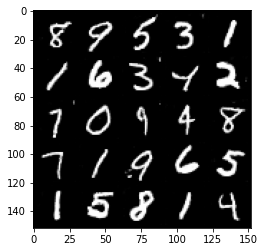

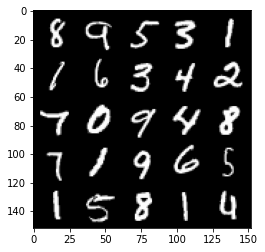

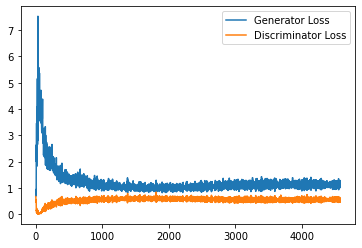

Step 92000: Generator loss: 1.1261330856084824, discriminator loss: 0.5582192890048027


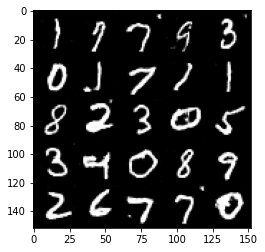

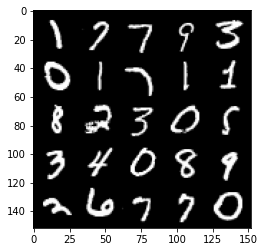

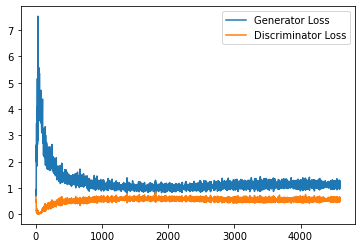

Step 92500: Generator loss: 1.1328295409679412, discriminator loss: 0.5596252208948136


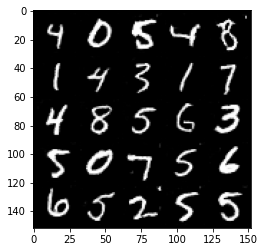

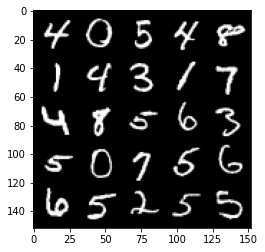

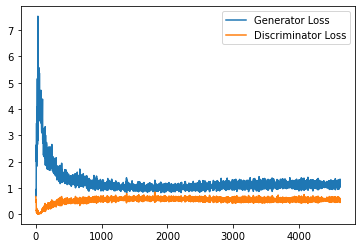

Step 93000: Generator loss: 1.1272467991113664, discriminator loss: 0.558342219889164


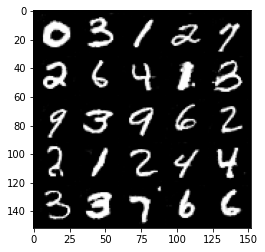

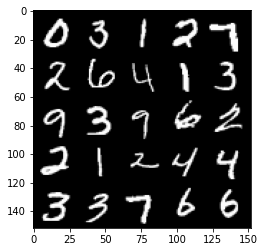

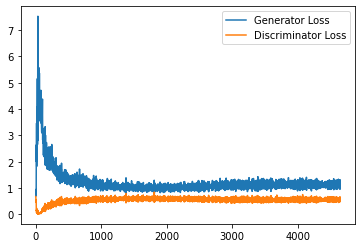

Step 93500: Generator loss: 1.1435159896612168, discriminator loss: 0.5548652493357659


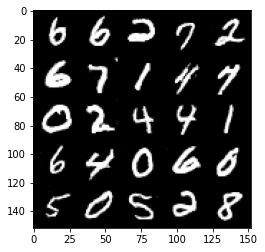

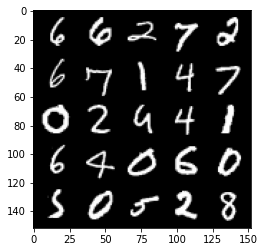

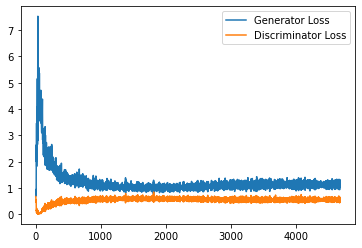

In [25]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [26]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

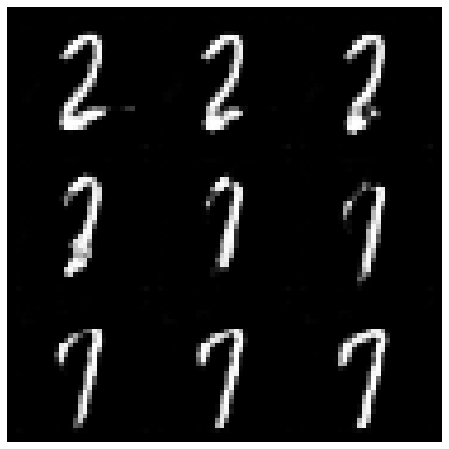

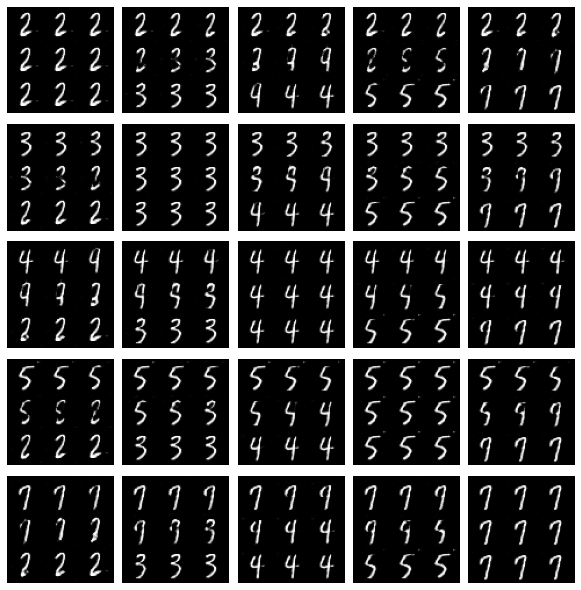

In [29]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 2 # Choose the start digit
### Change me! ###
end_plot_number = 7 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

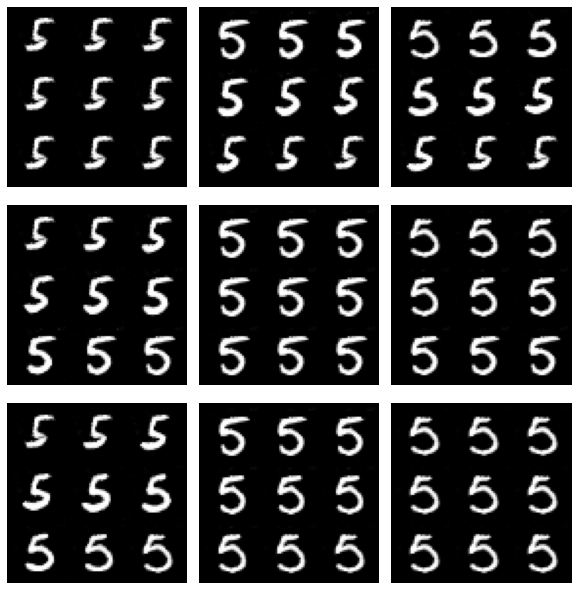

In [32]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 3 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()